# Homework 2: Augmented Reality with Planar Homographies

#### **For each question please refer to the handout for more details.**

Programming questions begin at **Q2**. **Remember to run all cells** and save the notebook to your local machine as a pdf for gradescope submission.

# Collaborators
**List your collaborators for all questions here**:


---

# Q1 Preliminaries

## Q1.1 The Direct Linear Transform


### Q1.1.1 (3 points)

How many degrees of freedom does **h** have?

---

There are 8 degrees of freedom for vector **h**, this is because images $\mathbf{x_1}$ and $\mathbf{x_2}$ are equivalent by a scale factor.

---

### Q1.1.2 (2 points)

How many point pairs are required to solve **h**?

---

At least 4 pairs of points are required to solve **h** since it has 8 degrees of freedom and each pair of points provides 2 equations. If more than 4 pairs of points are provided, least squares may be used to find the vector of best fit.

---

### Q1.1.3 (5 points)

Derive $\textbf{A}_i$

---

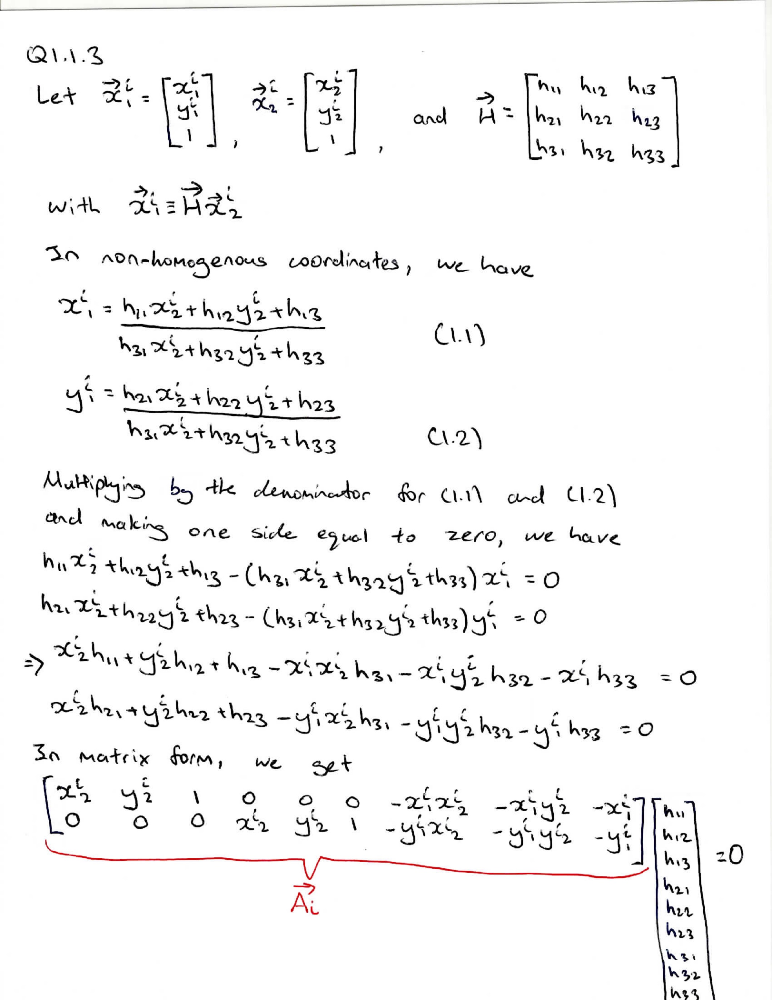

---

### Q1.1.4 (5 points)

What will be the trivial solution for **h**? Is the matrix **A** full rank? Why/Why not? What impact will it have on the singular values (i.e. eigenvalues of $\textbf{A}^T\textbf{A}$)?

---

The trivial solution is for $\mathbf{h}=0\in \mathbb{R}^9$ (i.e. zero vector). However, since we are assuming there exists a homography between images $\mathbf{x_1}$ and $\mathbf{x_2}$, the matrix $\mathbf{H}$ (and thus $\mathbf{h}$) cannot be the zero vector. This requires the matrix $\mathbf{A}$ to not be full rank (a way to think about this is that if $\mathbf{A}$ is full rank, then the left inverse of $\mathbf{A}$ exists and so the only solution to $\mathbf{Ah}=0$ is for $\mathbf{h}=0$). In fact, since the matrix $\mathbf{H}$ is defined up to a scale factor, it has 8 degrees of freedom. So $\mathbf{h}$ and $\lambda \mathbf{h}$ where $\lambda \in \mathbb{R}$ are both in the nullspace of $\mathbf{Ah}=0$. This requires the nullspace to be of dimension 1. Since $\mathbf{A}$ has 9 columns, by rank-nullity theorem, this requires $\mathbf{A}$ to be of rank 8. This also means that exactly one singular value of $\mathbf{A}$ will be zero. The right singular vector corresponding to this singular value lies in the nullspace of $\mathbf{A}$, thus providing the non-trivial solution for $\mathbf{h}$.
---

## Q1.2 Homography Theory Questions

### Q1.2.1 (5 points)

Prove that there exists a homography **H** that satisfies $\textbf{x}_1 ≡ \textbf{Hx}_2$, given two cameras separated by a pure rotation.

---

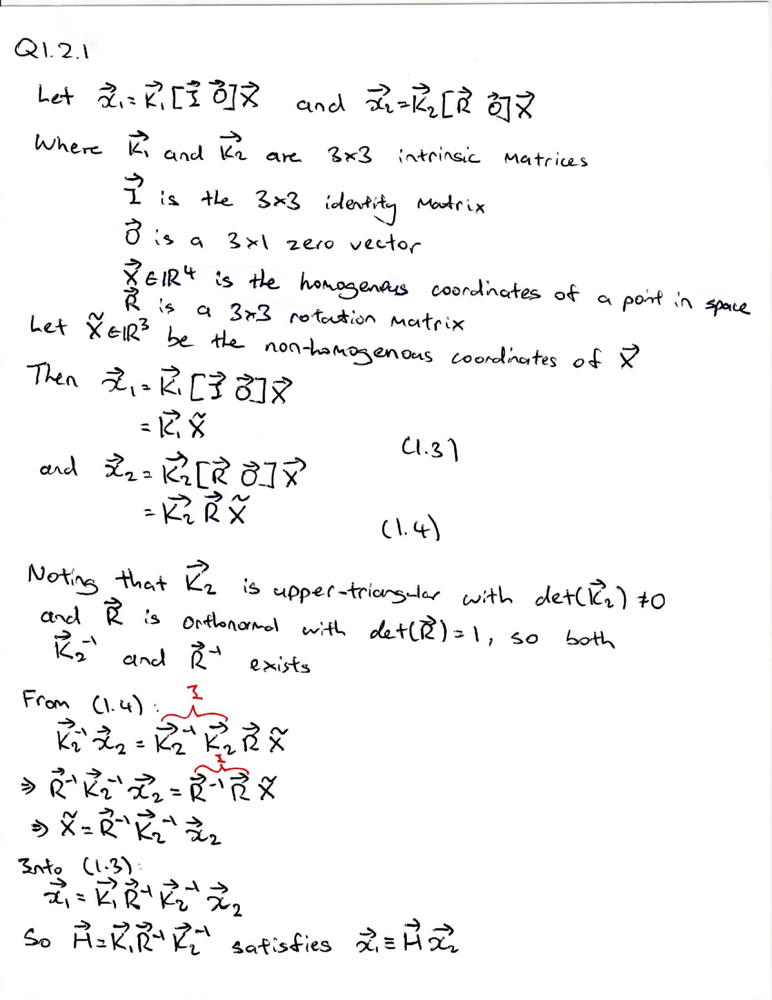

---

### Q1.2.2 (5 points):

Show that $\textbf{H}^2$ is the homography corresponding to a rotation of 2$\theta$.

---

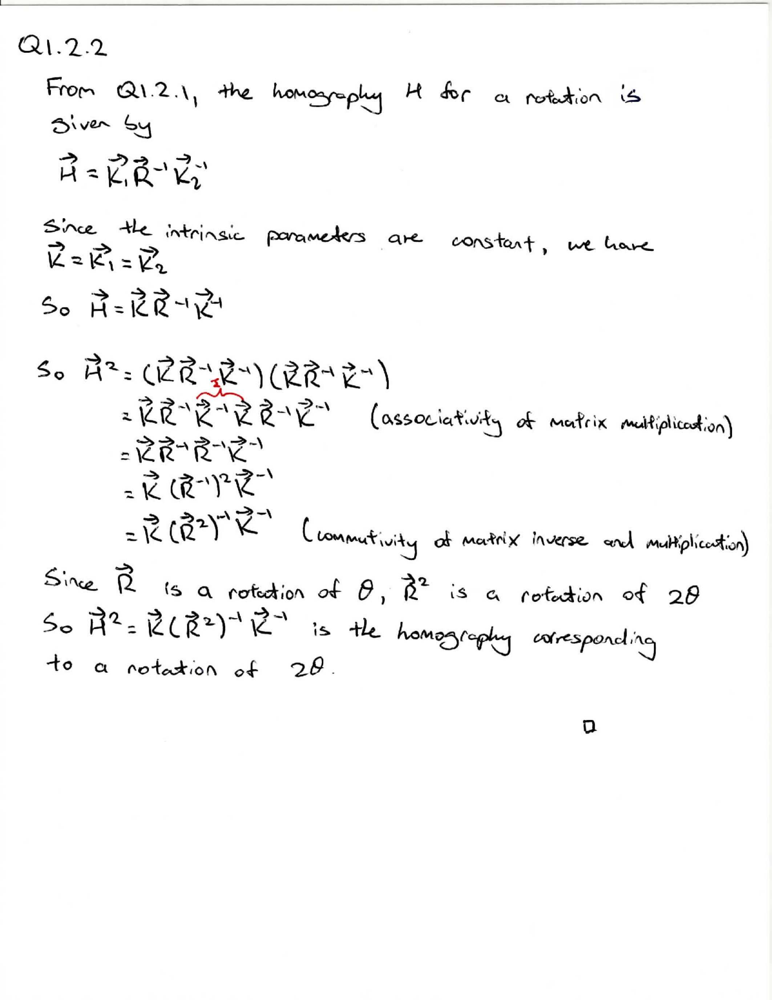

---

# Initialization

Run the following code to import the modules you'll need.

In [30]:
import os
import numpy as np
import cv2
import skimage.color
import pickle
from matplotlib import pyplot as plt
import scipy
from skimage.util import montage
import time

PATCHWIDTH = 9

def read_pickle(path):
    with open(path, "rb") as f:
        return pickle.load(f)

def write_pickle(path, data):
    with open(path, "wb") as f:
        pickle.dump(data, f)

def briefMatch(desc1,desc2,ratio):

    matches = skimage.feature.match_descriptors(desc1,desc2,
                                                'hamming',
                                                cross_check=True,
                                                max_ratio=ratio)
    return matches

def plotMatches(img1,img2,matches,locs1,locs2):

    fig, ax = plt.subplots(nrows=1, ncols=1)
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    plt.axis('off')
    skimage.feature.plot_matches(ax,img1,img2,locs1,locs2,
                                 matches,matches_color='r',only_matches=True)
    plt.show()
    return

def makeTestPattern(patchWidth, nbits):

    np.random.seed(0)
    compareX = patchWidth*patchWidth * np.random.random((nbits,1))
    compareX = np.floor(compareX).astype(int)
    np.random.seed(1)
    compareY = patchWidth*patchWidth * np.random.random((nbits,1))
    compareY = np.floor(compareY).astype(int)

    return (compareX, compareY)

def computePixel(img, idx1, idx2, width, center):

    halfWidth = width // 2
    col1 = idx1 % width - halfWidth
    row1 = idx1 // width - halfWidth
    col2 = idx2 % width - halfWidth
    row2 = idx2 // width - halfWidth
    return 1 if img[int(center[0]+row1)][int(center[1]+col1)] < img[int(center[0]+row2)][int(center[1]+col2)] else 0

def computeBrief(img, locs):

    patchWidth = 9
    nbits = 256
    compareX, compareY = makeTestPattern(patchWidth,nbits)
    m, n = img.shape

    halfWidth = patchWidth//2

    locs = np.array(list(filter(lambda x: halfWidth <= x[0] < m-halfWidth and halfWidth <= x[1] < n-halfWidth, locs)))
    desc = np.array([list(map(lambda x: computePixel(img, x[0], x[1], patchWidth, c), zip(compareX, compareY))) for c in locs])

    return desc, locs

def corner_detection(img, sigma):

    # fast method
    result_img = skimage.feature.corner_fast(img, n=PATCHWIDTH, threshold=sigma)
    locs = skimage.feature.corner_peaks(result_img, min_distance=1)
    return locs

def loadVid(path):

    # Create a VideoCapture object and read from input file
    # If the input is the camera, pass 0 instead of the video file name

    cap = cv2.VideoCapture(path)

    # get fps, width, and height
    fps = cap.get(cv2.CAP_PROP_FPS)
    width  = cap.get(cv2.CAP_PROP_FRAME_WIDTH)
    height = cap.get(cv2.CAP_PROP_FRAME_HEIGHT)

    # Append frames to list
    frames = []

    # Check if camera opened successfully
    if cap.isOpened()== False:
        print("Error opening video stream or file")

    # Read until video is completed
    while(cap.isOpened()):

        # Capture frame-by-frame
        ret, frame = cap.read()

        if ret:
            #Store the resulting frame
            frames.append(frame)
        else:
            break

    # When everything done, release the video capture object
    cap.release()
    frames = np.stack(frames)

    return frames, fps, width, height

# Download data

Download the required data and setup the results directory. If running on colab, DATA_PARENT_DIR must be <br> DATA_PARENT_DIR = '/content/' <br> <br> Otherwise, use the local directory of your choosing. Data will be downloaded to DATA_PARENT_DIR/hw3_data and a subdirectory DATA_PARENT_DIR/results will be created.

In [31]:
# Only change this if you are running locally
# Default on colab: DATA_PARENT_DIR = '/content/'

# Data will be downloaded to DATA_PARENT_DIR/hw3_data
# A subdirectory DATA_PARENT_DIR/results will be created

DATA_PARENT_DIR = '/content/'

if not os.path.exists(DATA_PARENT_DIR):
  raise RuntimeError('DATA_PARENT_DIR does not exist: ', DATA_PARENT_DIR)

RES_DIR = os.path.join(DATA_PARENT_DIR, 'results')
if not os.path.exists(RES_DIR):
  os.mkdir(RES_DIR)
  print('made directory: ', RES_DIR)


#paths different files are saved to
# OPTIONAL:
# feel free to change if funning locally
ROT_MATCHES_PATH = os.path.join(RES_DIR, 'brief_rot_test.pkl')
ROT_INV_MATCHES_PATH = os.path.join(RES_DIR, 'ec_brief_rot_inv_test.pkl')
AR_VID_FRAMES_PATH = os.path.join(RES_DIR, 'q_3_1_frames.npy')
AR_VID_FRAMES_EC_PATH = os.path.join(RES_DIR, 'q_3_2_frames.npy')

HW3_SUBDIR = 'hw3_data'
DATA_DIR = os.path.join(DATA_PARENT_DIR, HW3_SUBDIR)
ZIP_PATH = DATA_DIR + '.zip'
if not os.path.exists(DATA_DIR):
  !wget 'https://www.andrew.cmu.edu/user/hfreeman/data/16720_spring/hw3_data.zip' -O $ZIP_PATH
  !unzip -qq $ZIP_PATH -d $DATA_PARENT_DIR

# Q2 Computing Planar Homographies

## Q2.1 Feature Detection and Matching

### Q2.1.1 (5 points):

How is the FAST detector different from the Harris corner detector that you've seen in the lectures? Can you comment on its computation performance compared to the Harris corner detector?

---

Both the FAST detector and the Harris detector are corner detectors that look for variations in the intensity values around a candidate pixel. The Harris detector looks for these variations by computing the weighted sums of the products of derivatives around a neighborhood at each candidate pixel. A candidate pixel is deemed a "corner" when the x- and y-direction derivatives of the neighboring intensity values is large (i.e. when the principal component ellipse is large and roughly circular). The FAST detector compares a candidate pixel's intensity to the intensity values of the pixels around a circle of the candidate (usually a radius of 3 pixels is used so 16 pixels are compared for each candidate pixel). Thresholds $t$ and $n$ are predefined so that a candidate pixel is deemed a "corner" when at least $n$ (usually 12) contiguous pixels around a circle of the candidate has intensity values greater than $I+t$ or less than $I-t$, where $I$ is the intensity value of the candidate pixel.

The computational performance of the FAST detector in practice is much faster than the Harris detector. This is because it only performs simple intensity comparisons and do not need to perform costly gradient computations. However, the Harris detector is generally more accurate and stable in detecting corners, so there is a tradeoff between real-time speed and accuracy.

---

### Q2.1.2 (5 points):

How is the BRIEF descriptor different from the filterbanks you've seen in the lectures? Could you use any one of the those filter banks as a descriptor?

---

Both BRIEF descriptors and filter banks are used for image feature extraction. The BRIEF descriptor takes an $S\times S$ patch around a keypoint and outputs a string of binary values of comparisons of intensity values between random pixels in the patch. Filter banks convolutes the image using different filters (e.g. Gaussians, derivative of Gaussians, Laplacian of Gaussians) and concatenates the results together. They differ from BRIEF descriptors in that filter banks normally extract features for the entire image (such as edges, textures, rapid intensity changes, etc), rather than the features at specific keypoints represented by BRIEF descriptors. Thus, BRIEF is more suited towards keypoint descriptors, while filter banks are more suited towards global descriptors.

Another way they are different is that BRIEF descriptors encode the description in binary whereas filter bank descriptors does not. This allows BRIEF descriptors to be less memory intensive and applicable to real-time applications.

Hypothetically, you could take an $S\times S$ patch around each keypoint and convolute the patch with different filters in the filter bank. The concatenated results (or the statistics/histogram of the results) would then be our keypoint descriptor. This was the motivation for the GIST descriptor. However, using filter bank descriptors may become computationally expensive, result in high-dimensional descriptors, and is sensitive to the input hyperparameters, making them less suitable for tasks such as keypoint matching (which enumerates over all combinations of keypoints between images). Additionally, not all filter banks should be used. Convoluting with filter banks that are coarse-grained scaled might not be optimal. This is because patches usually only have at most a few hundred pixels in them, convoluting with a coarse-grained filter may remove too much information for the descriptor to be useful.

---

### Q2.1.3 (5 points):

Describe how the Hamming distance and Nearest Neighbor can be used to match interest points with BRIEF descriptors. What benefits does the Hamming distance have over a more conventional Euclidean distance measure in our setting?

---

BRIEF descriptors are binary strings that describe the features of each keypoint. Since the descriptor is binary, it is natural to compare how many bits are the same or different between two binary strings. The Hamming distance does just this by counting the number of bits that are different between two bit strings. Two keypoints that are the same point in space would have similar BRIEF descriptors, and thus the difference between the two binary strings would be small, resulting in a small Hamming distance. To match keypoints between one image to another, we enumerate over all keypoint BRIEF descriptors in the second image and compute their Hamming distance. The nearest neighbor is the keypoint in the second image that has the smallest Hamming distance from the keypoint in the first image. We then match these two keypoints together as they most likely correspond to the same point in space.

Perhaps the most significant advantage Hamming distance has over other distances is its low computational cost. Bit-wise comparisons are very efficient compared to the floating-point operations used for conventional comparisons. It is also very simple to implement and also uses less space to store in memory as compared to floating-point vectors. Therefore, for binary descriptors such as BRIEF, it is almost always better to use Hamming distance over more conventional Euclidean distance measures.

---

### Q2.1.4 (10 points):

#### Implement the function matchPics()

In [32]:
def matchPics(I1, I2, ratio, sigma):
    """
    Match features across images

    Input
    -----
    I1, I2: Source images (RGB or Grayscale uint8)
    ratio: ratio for BRIEF feature descriptor
    sigma: threshold for corner detection using FAST feature detector

    Returns
    -------
    matches: List of indices of matched features across I1, I2 [p x 2]
    locs1, locs2: Pixel coordinates of matches [N x 2]
    """

    # ===== your code here! =====

    # TODO: Convert images to GrayScale
    # Input images can be either RGB or Grayscale uint8 (0 -> 255). Both need
    # to be supported.
    # Input images must be converted to normalized Grayscale (0.0 -> 1.0)
    # skimage.color.rgb2gray may be useful if the input is RGB.

    if (len(I1.shape) == 3) and (I1.shape[2] == 3):
        I1_grey = skimage.color.rgb2gray(I1)
    else:
        I1_grey = skimage.exposure.rescale_intensity(
            I1, in_range='image', out_range=(0, 1))

    if (len(I2.shape) == 3) and (I2.shape[2] == 3):
        I2_grey = skimage.color.rgb2gray(I2)
    else:
        I2_grey = skimage.exposure.rescale_intensity(
            I2, in_range='image', out_range=(0, 1))

    # TODO: Detect features in both images
    locs1 = corner_detection(I1_grey, sigma)
    locs2 = corner_detection(I2_grey, sigma)

    # TODO: Obtain descriptors for the computed feature locations
    desc1, locs1 = computeBrief(I1_grey, locs1)
    desc2, locs2 = computeBrief(I2_grey, locs2)

    # TODO: Match features using the descriptors
    matches = briefMatch(desc1, desc2, ratio)

    # NOTE: Returns full list of feature locations instead of matched locations,
    # this is because plotMatches takes in locs1 and locs2 as feature points
    # instead of matched points

    # ==== end of code ====

    return matches, locs1, locs2

#### Implement the function displayMatched

In [33]:
def displayMatched(I1, I2, ratio, sigma):
    """
    Displays matches between two images

    Input
    -----
    I1, I2: Source images
    ratio: ratio for BRIEF feature descriptor
    sigma: threshold for corner detection using FAST feature detector
    """

    print('Displaying matches for ratio: ', ratio, ' and sigma: ', sigma)

    # ===== your code here! =====
    # TODO: Use matchPics and plotMatches to visualize your results

    matches, locs1, locs2 = matchPics(I1, I2, ratio, sigma)

    plotMatches(I1, I2, matches, locs1, locs2)

    # ==== end of code ====


#### Visualize the matches

Use the cell below to visualize the matches. The resulting figure should look similar (but not necessarily identical) to Figure 2.

Feel free to play around with the images and parameters. Please use the original images when submitting the report.

Figure 2 parameters:

*   image1_name = "cv_cover.jpg"
*   image1_name = "cv_desk.png"
*   ratio = 0.7
*   sigma = 0.15

Displaying matches for ratio:  0.7  and sigma:  0.15


<ipython-input-30-93856fa3ecc0>:58: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return 1 if img[int(center[0]+row1)][int(center[1]+col1)] < img[int(center[0]+row2)][int(center[1]+col2)] else 0
<ipython-input-30-93856fa3ecc0>:35: FutureWarning: `plot_matches` is deprecated since version 0.23 and will be removed in version 0.25. Use `skimage.feature.plot_matched_features` instead.
  skimage.feature.plot_matches(ax,img1,img2,locs1,locs2,


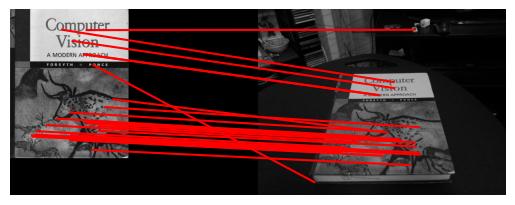

In [34]:
# Feel free to play around with these parameters
# BUT when submitting the report use the original images
image1_name = "cv_cover.jpg"
image2_name = "cv_desk.png"
ratio = 0.7
sigma = 0.15

image1_path = os.path.join(DATA_DIR, image1_name)
image2_path = os.path.join(DATA_DIR, image2_name)

image1 = cv2.imread(image1_path)
image2 = cv2.imread(image2_path)

#bgr to rgb
if len(image1.shape) == 3 and image1.shape[2] == 3:
  image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

if len(image2.shape) == 3 and image2.shape[2] == 3:
  image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

displayMatched(image1, image2, ratio, sigma)

### Q2.1.5 (10 points):

Experiment with different sigma and ratio values. Conduct a small ablation study, and include the figures displaying the matched features with various parameters in your write-up. Explain the effect of these two paremeters respectively.

---

Explain the effect of these two parameters: We note that both the sigma and ratio values only permit values in the interval $[0, 1]$. In general, increasing the ratio value tends to increase the number of matched points, while increasing the sigma value tends to decrease the number of matched points.

Looking into the initialization code, the ratio value feeds into the $\texttt{max_ratio}$ parameter in $\texttt{skimage.feature.match_descriptors}$. The $\texttt{max_ratio}$ parameter's purpose is to only match nearest neighbor keypoints if their BRIEF descriptor's Hamming distance divided by the Hamming distance with the second nearest neighbor is less than $\texttt{max_ratio}$. By lowering $\texttt{max_ratio}$, we remove matches where there isn't a clear best match, improving the reliability of the matching process. However, for sufficiently low values of $\texttt{max_ratio}$, no matches will be made as no keypoint nearest neighbor pair has a Hamming distance that low compared to the second nearest neighbor.

Similarly, the sigma value feeds into the $\texttt{threshold}$ parameter in $\texttt{skimage.feature.corner_fast}$. It defines the minimum difference in intensity for pixels in a circle around a candidate pixel for it to be considered significant (i.e. it is the $t$ value in Q2.1.1). A higher threshold (sigma value) means that only larger intensity differences are considered significant, so fewer keypoints will be detected, and the converse is true for a lower threshold. For sufficiently high sigma values, no keypoints will be detected as there are no intensity variations that large for a grayscale image normalized to between 0 and 1.

From the ablation study, the optimal sigma and ratio values seem to be around $sigma \in [0.1, 0.4]$ and $ratio \in [0.6, 0.8]$. The sigma ratio is just enough so that "interesting" corners can be detected, while the ratio value is just so that only the more "confident" keypoint pairs are matched. Too high of a ratio value will result in many "bad" keypoint pairs being matched, while too low of a ratio value will result in no pairs being matched. Similarly, too high of a sigma value will cause no keypoints to be detected, whole too low of a sigma value will cause almost every pixel in the image to be labeled a keypoint.

---

Displaying matches for ratio:  0.1  and sigma:  0.1


<ipython-input-30-93856fa3ecc0>:58: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return 1 if img[int(center[0]+row1)][int(center[1]+col1)] < img[int(center[0]+row2)][int(center[1]+col2)] else 0
<ipython-input-30-93856fa3ecc0>:35: FutureWarning: `plot_matches` is deprecated since version 0.23 and will be removed in version 0.25. Use `skimage.feature.plot_matched_features` instead.
  skimage.feature.plot_matches(ax,img1,img2,locs1,locs2,


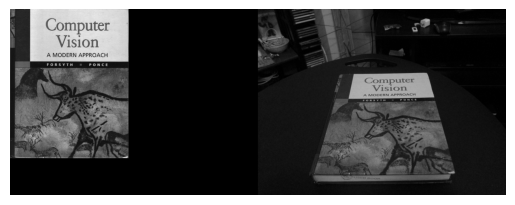

Displaying matches for ratio:  0.1  and sigma:  0.2


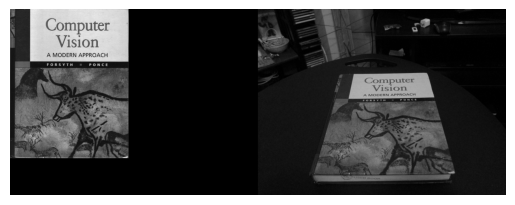

Displaying matches for ratio:  0.1  and sigma:  0.3


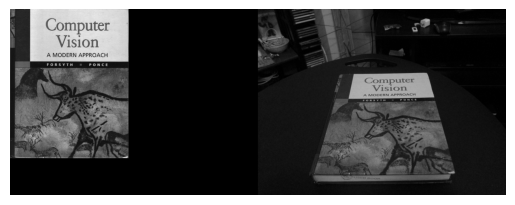

Displaying matches for ratio:  0.1  and sigma:  0.4


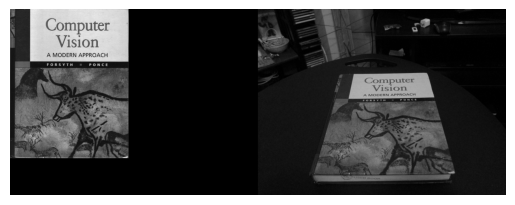

Displaying matches for ratio:  0.1  and sigma:  0.5


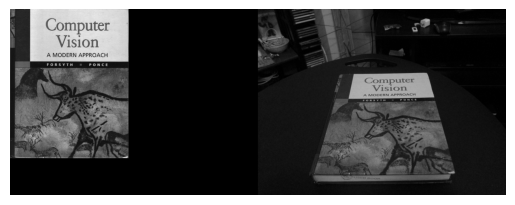

Displaying matches for ratio:  0.1  and sigma:  0.6


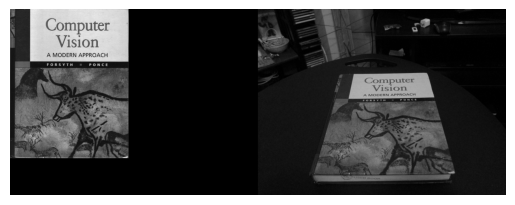

Displaying matches for ratio:  0.1  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.1  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.1  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.1  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  0.2  and sigma:  0.1


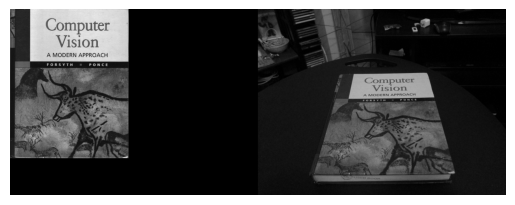

Displaying matches for ratio:  0.2  and sigma:  0.2


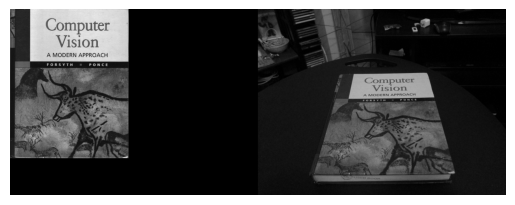

Displaying matches for ratio:  0.2  and sigma:  0.3


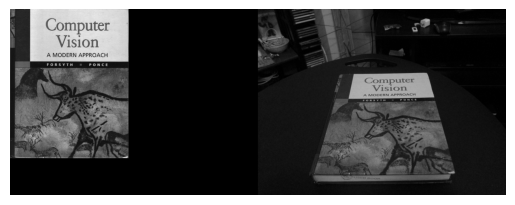

Displaying matches for ratio:  0.2  and sigma:  0.4


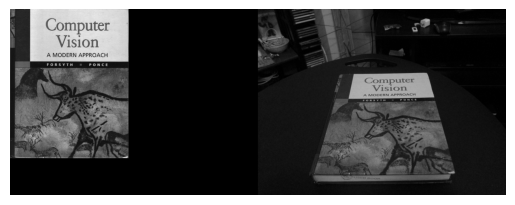

Displaying matches for ratio:  0.2  and sigma:  0.5


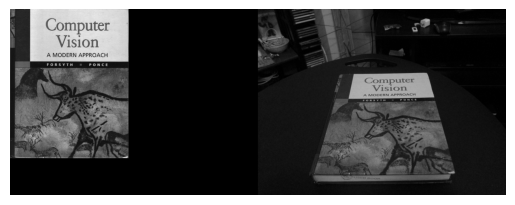

Displaying matches for ratio:  0.2  and sigma:  0.6


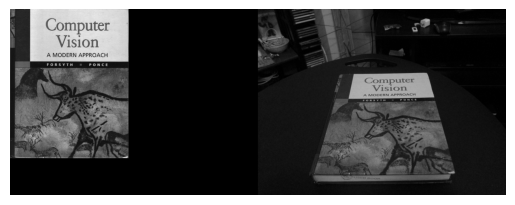

Displaying matches for ratio:  0.2  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.2  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.2  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.2  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  0.3  and sigma:  0.1


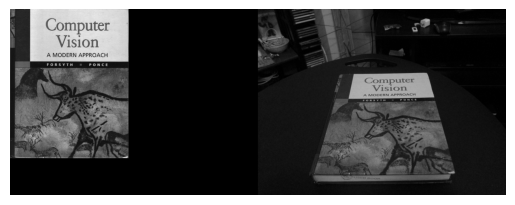

Displaying matches for ratio:  0.3  and sigma:  0.2


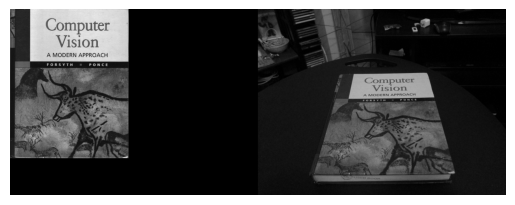

Displaying matches for ratio:  0.3  and sigma:  0.3


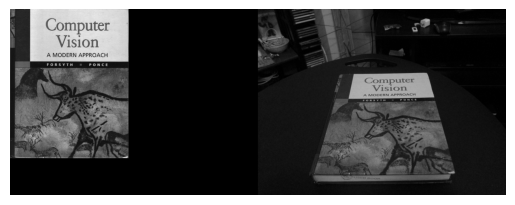

Displaying matches for ratio:  0.3  and sigma:  0.4


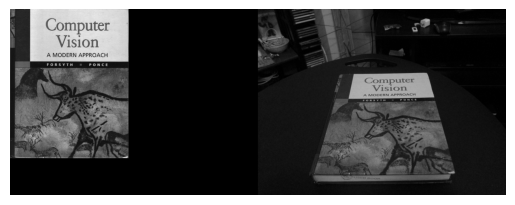

Displaying matches for ratio:  0.3  and sigma:  0.5


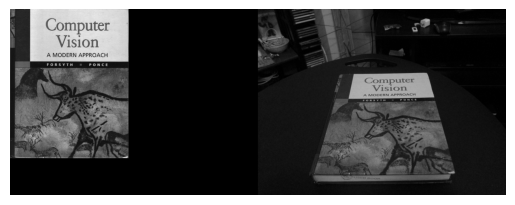

Displaying matches for ratio:  0.3  and sigma:  0.6


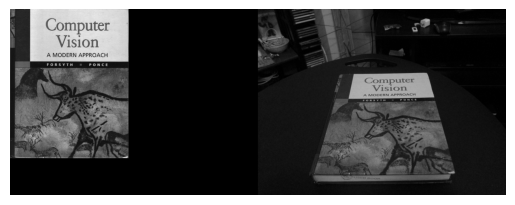

Displaying matches for ratio:  0.3  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.3  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.3  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.3  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  0.4  and sigma:  0.1


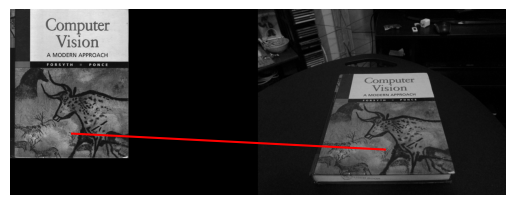

Displaying matches for ratio:  0.4  and sigma:  0.2


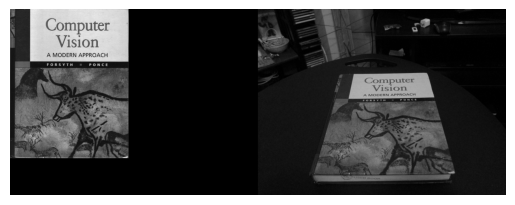

Displaying matches for ratio:  0.4  and sigma:  0.3


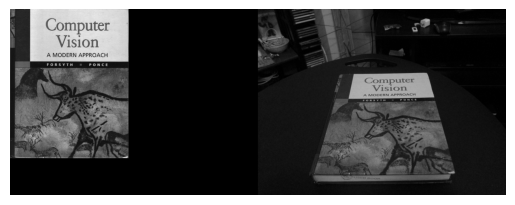

Displaying matches for ratio:  0.4  and sigma:  0.4


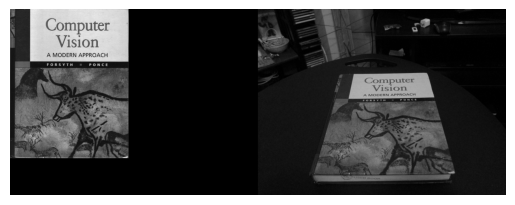

Displaying matches for ratio:  0.4  and sigma:  0.5


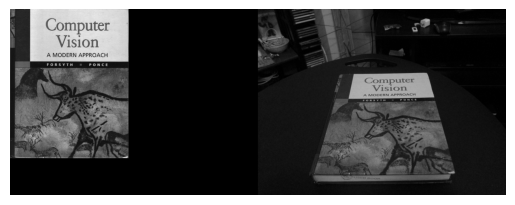

Displaying matches for ratio:  0.4  and sigma:  0.6


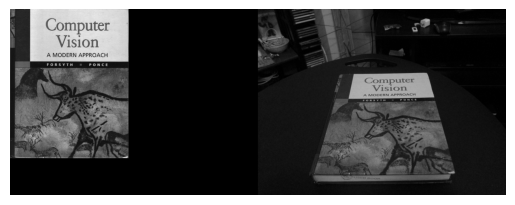

Displaying matches for ratio:  0.4  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.4  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.4  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.4  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  0.5  and sigma:  0.1


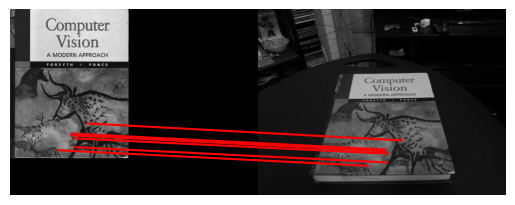

Displaying matches for ratio:  0.5  and sigma:  0.2


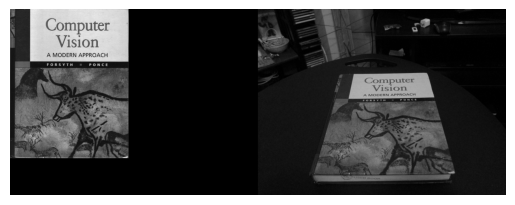

Displaying matches for ratio:  0.5  and sigma:  0.3


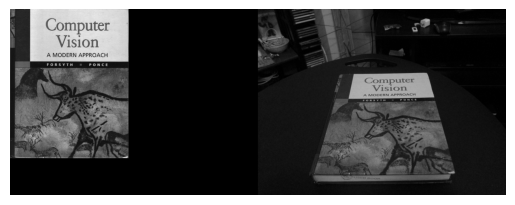

Displaying matches for ratio:  0.5  and sigma:  0.4


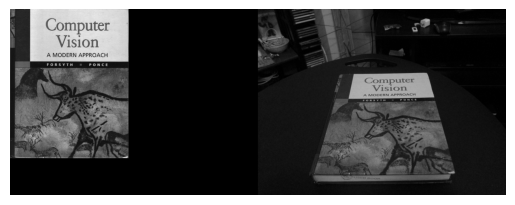

Displaying matches for ratio:  0.5  and sigma:  0.5


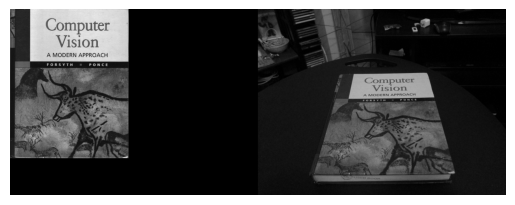

Displaying matches for ratio:  0.5  and sigma:  0.6


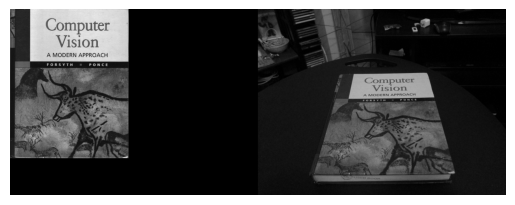

Displaying matches for ratio:  0.5  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.5  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.5  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.5  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  0.6  and sigma:  0.1


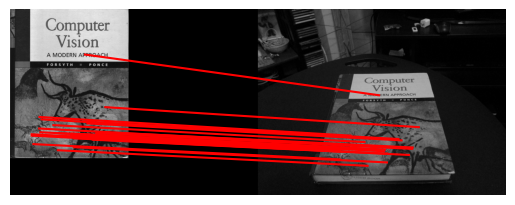

Displaying matches for ratio:  0.6  and sigma:  0.2


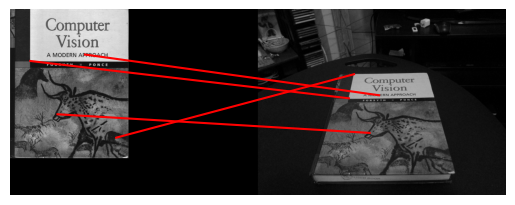

Displaying matches for ratio:  0.6  and sigma:  0.3


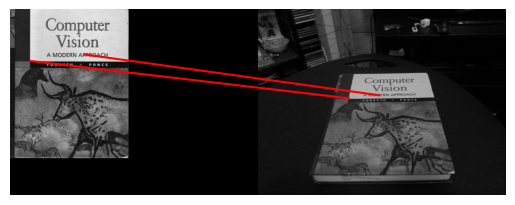

Displaying matches for ratio:  0.6  and sigma:  0.4


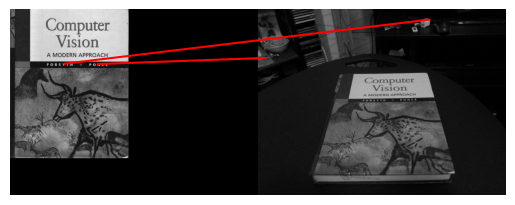

Displaying matches for ratio:  0.6  and sigma:  0.5


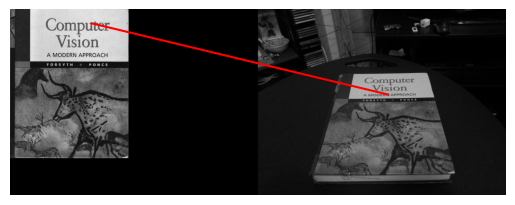

Displaying matches for ratio:  0.6  and sigma:  0.6


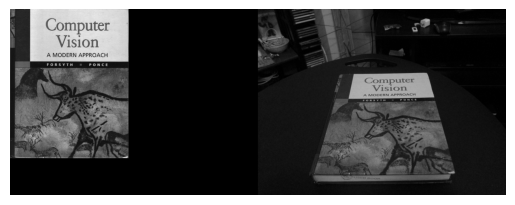

Displaying matches for ratio:  0.6  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.6  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.6  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.6  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  0.7  and sigma:  0.1


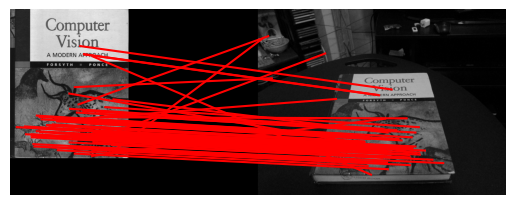

Displaying matches for ratio:  0.7  and sigma:  0.2


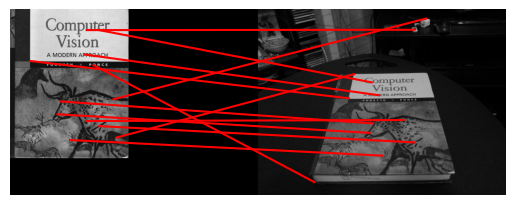

Displaying matches for ratio:  0.7  and sigma:  0.3


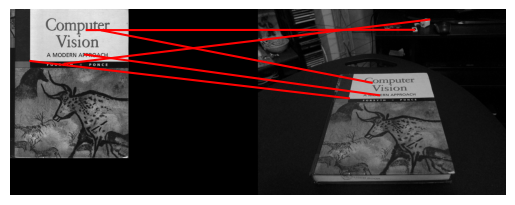

Displaying matches for ratio:  0.7  and sigma:  0.4


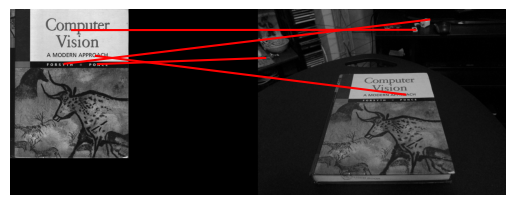

Displaying matches for ratio:  0.7  and sigma:  0.5


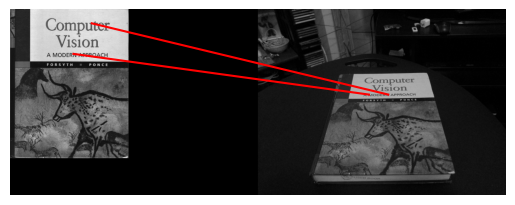

Displaying matches for ratio:  0.7  and sigma:  0.6


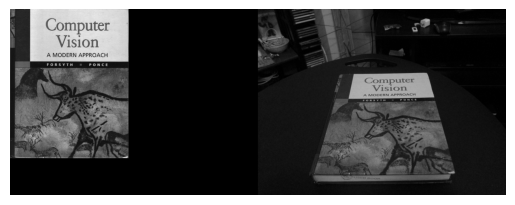

Displaying matches for ratio:  0.7  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.7  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.7  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.7  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  0.8  and sigma:  0.1


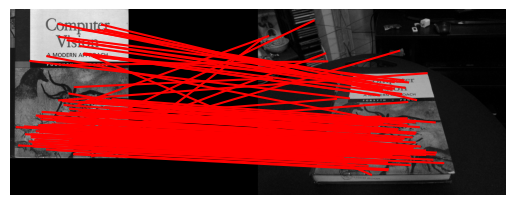

Displaying matches for ratio:  0.8  and sigma:  0.2


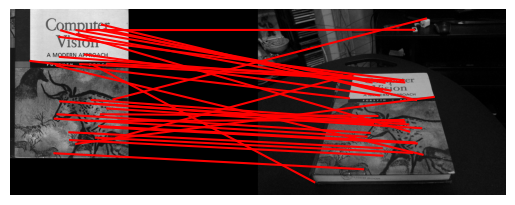

Displaying matches for ratio:  0.8  and sigma:  0.3


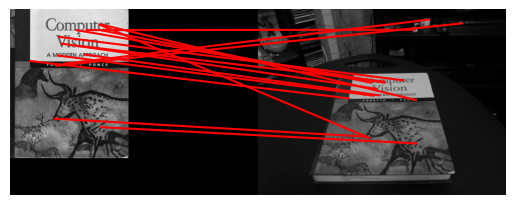

Displaying matches for ratio:  0.8  and sigma:  0.4


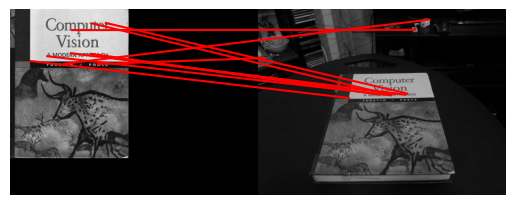

Displaying matches for ratio:  0.8  and sigma:  0.5


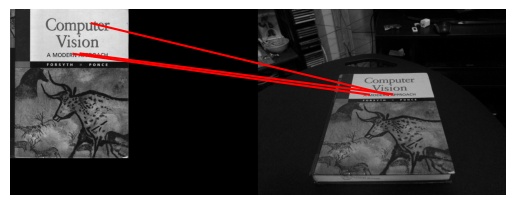

Displaying matches for ratio:  0.8  and sigma:  0.6


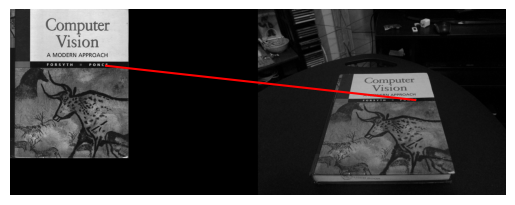

Displaying matches for ratio:  0.8  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.8  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.8  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.8  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  0.9  and sigma:  0.1


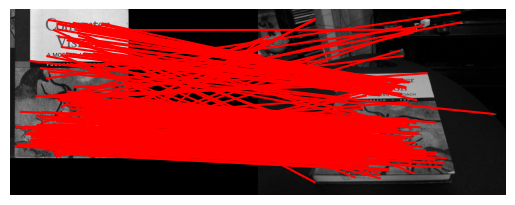

Displaying matches for ratio:  0.9  and sigma:  0.2


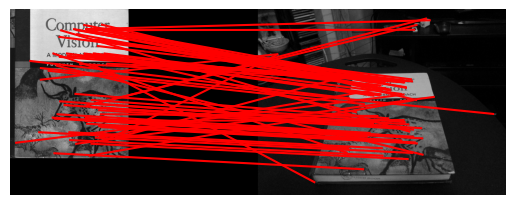

Displaying matches for ratio:  0.9  and sigma:  0.3


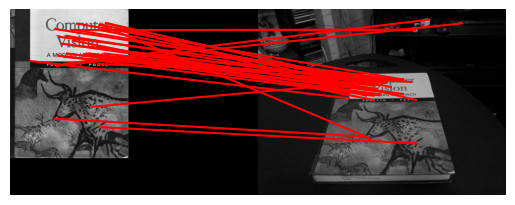

Displaying matches for ratio:  0.9  and sigma:  0.4


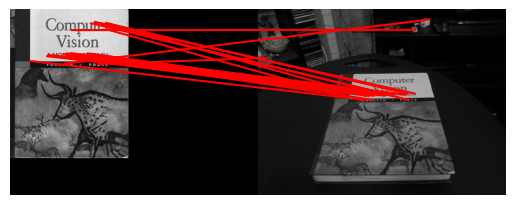

Displaying matches for ratio:  0.9  and sigma:  0.5


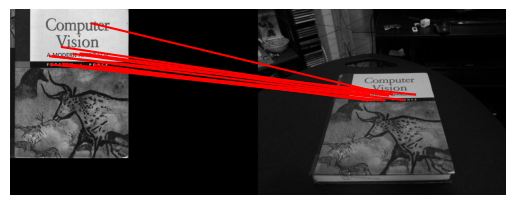

Displaying matches for ratio:  0.9  and sigma:  0.6


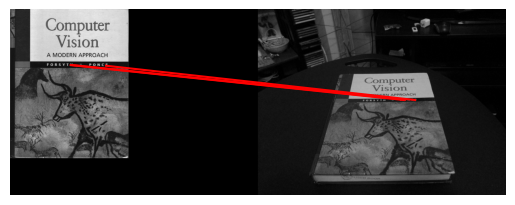

Displaying matches for ratio:  0.9  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  0.9  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  0.9  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  0.9  and sigma:  1
The corner detector found no corners
Displaying matches for ratio:  1  and sigma:  0.1


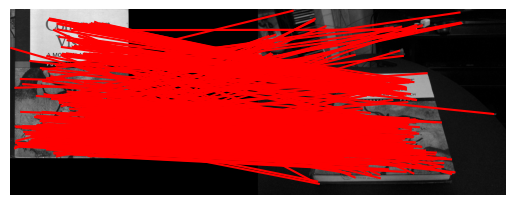

Displaying matches for ratio:  1  and sigma:  0.2


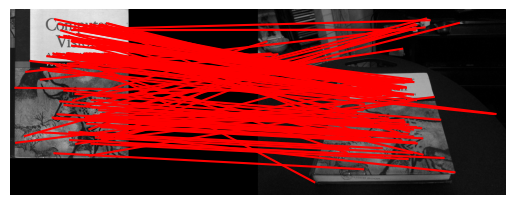

Displaying matches for ratio:  1  and sigma:  0.3


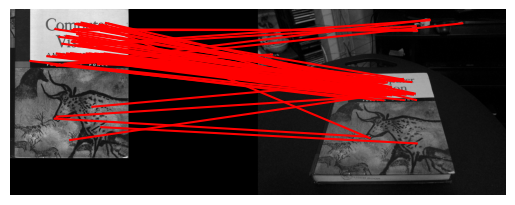

Displaying matches for ratio:  1  and sigma:  0.4


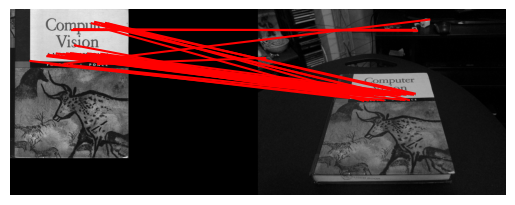

Displaying matches for ratio:  1  and sigma:  0.5


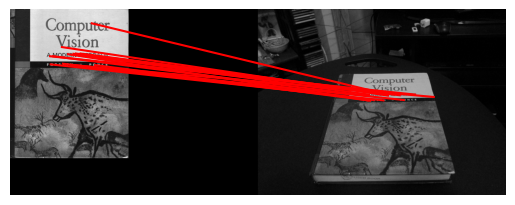

Displaying matches for ratio:  1  and sigma:  0.6


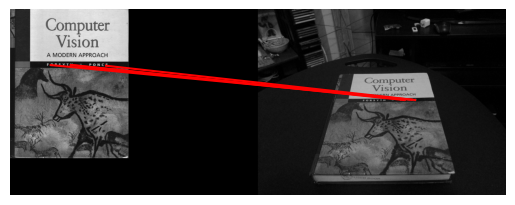

Displaying matches for ratio:  1  and sigma:  0.7
The corner detector found no corners
Displaying matches for ratio:  1  and sigma:  0.8
The corner detector found no corners
Displaying matches for ratio:  1  and sigma:  0.9
The corner detector found no corners
Displaying matches for ratio:  1  and sigma:  1
The corner detector found no corners


In [35]:
image1_name = "cv_cover.jpg"
image2_name = "cv_desk.png"

image1_path = os.path.join(DATA_DIR, image1_name)
image2_path = os.path.join(DATA_DIR, image2_name)

image1 = cv2.imread(image1_path)
image2 = cv2.imread(image2_path)

#bgr to rgb
if len(image1.shape) == 3 and image1.shape[2] == 3:
  image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2RGB)

if len(image2.shape) == 3 and image2.shape[2] == 3:
  image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2RGB)

# ===== your code here! =====
# Experiment with different sigma and ratio values.
# Use displayMatches to visualize.
# Include the matched feature figures in the write-up.

ratio_list = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]
sigma_list = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]

for ratio in ratio_list:
    for sigma in sigma_list:
        try:
            displayMatched(image1, image2, ratio, sigma)
        except IndexError:
            print('The corner detector found no corners')

# ==== end of code ====

### Q2.1.6 (10 points):

#### Implement the function briefRot

In [36]:
def briefRot(min_deg, max_deg, deg_inc, ratio, sigma, filename):
    """
    Tests Brief with rotations.

    Input
    -----
    min_deg: minimum degree to rotate image
    max_deg: maximum degree to rotate image
    deg_inc: number of degrees to increment when iterating
    ratio: ratio for BRIEF feature descriptor
    sigma: threshold for corner detection using FAST feature detector
    filename: filename of image to rotate

    """

    if not os.path.exists(RES_DIR):
      raise RuntimeError('RES_DIR does not exist. did you run all cells?')

    # Read the image and convert bgr to rgb
    image_path = os.path.join(DATA_DIR, filename)
    image = cv2.imread(image_path)
    if len(image.shape) == 3 and image.shape[2] == 3:
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    match_degrees = [] # stores the degrees of rotation
    match_counts = [] # stores the number of matches at each degree of rotation

    for i in range(min_deg, max_deg, deg_inc):
        print(i)

        # ===== your code here! =====
        # TODO: Rotate Image (Hint: use scipy.ndimage.rotate)
        rotated_image = scipy.ndimage.rotate(image, i)

        # TODO: Match features in images
        matches, locs1, locs2 = matchPics(image, rotated_image, ratio, sigma)

        # TODO: visualizes matches at at least 3 different orientations
        # to include in your report
        # (Hint: use plotMatches)
        if (i == 0) or (i == 30) or (i == 60) or (i == 90) or (i == 180) or (i == 270):
            plotMatches(image, rotated_image, matches, locs1, locs2)

        # TODO: Update match_degrees and match_counts (see descriptions above)
        match_degrees.append(i)
        match_counts.append(matches.shape[0])

        # ==== end of code ====

    # Save to pickle file
    matches_to_save = [match_counts, match_degrees, deg_inc]
    write_pickle(ROT_MATCHES_PATH, matches_to_save)

def dispBriefRotHist(matches_path=ROT_MATCHES_PATH):
    # Check if pickle file exists
    if not os.path.exists(matches_path):
      raise RuntimeError('matches_path does not exist. did you call briefRot?')

    # Read from pickle file
    match_counts, match_degrees, deg_inc = read_pickle(matches_path)

    # Display histogram
    # Bins are centered and separated every 10 degrees
    plt.figure()
    bins = [x - deg_inc/2 for x in match_degrees]
    bins.append(bins[-1] + deg_inc)
    plt.hist(match_degrees, bins=bins, weights=match_counts, log=True)
    #plt.hist(match_degrees, bins=[10 * (x-0.5) for x in range(37)], weights=match_counts, log=True)
    plt.title("Histogram of BREIF matches")
    plt.ylabel("# of matches")
    plt.xlabel("Rotation (deg)")
    plt.tight_layout()

    output_path = os.path.join(RES_DIR, 'histogram.png')
    plt.savefig(output_path)

#### Visualize the matches under rotation

See debugging tips in handout.


0


<ipython-input-30-93856fa3ecc0>:58: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return 1 if img[int(center[0]+row1)][int(center[1]+col1)] < img[int(center[0]+row2)][int(center[1]+col2)] else 0
<ipython-input-30-93856fa3ecc0>:35: FutureWarning: `plot_matches` is deprecated since version 0.23 and will be removed in version 0.25. Use `skimage.feature.plot_matched_features` instead.
  skimage.feature.plot_matches(ax,img1,img2,locs1,locs2,


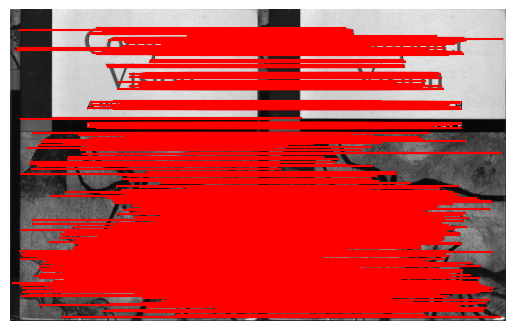

10
20
30


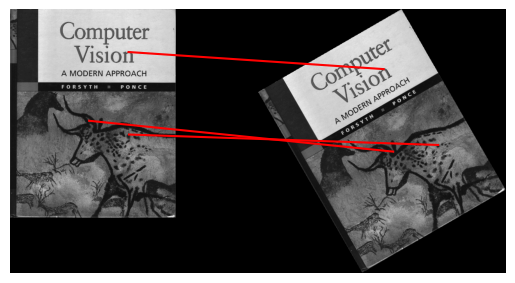

40
50
60


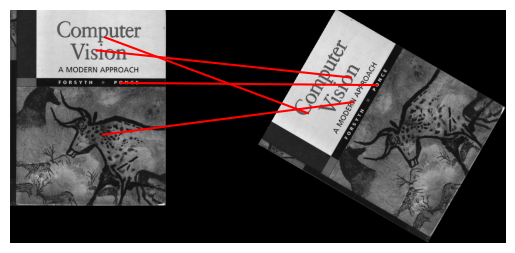

70
80
90


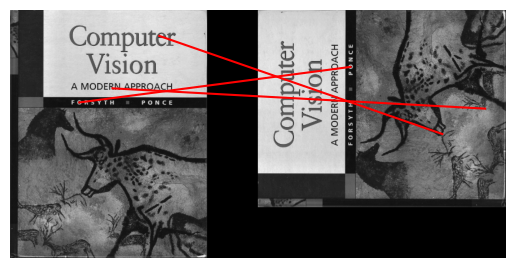

100
110
120
130
140
150
160
170
180


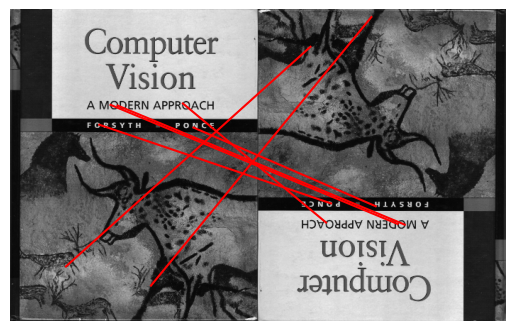

190
200
210
220
230
240
250
260
270


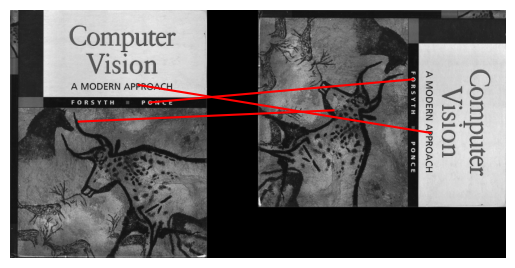

280
290
300
310
320
330
340
350


In [37]:
# defaults are:
# min_deg = 0
# max_deg = 360
# deg_inc = 10
# ratio = 0.7
# sigma = 0.15
# filename = 'cv_cover.jpg'

# Controls the rotation degrees
min_deg = 0
max_deg = 360
deg_inc = 10

# Brief feature descriptor and Fast feature detector paremeters
# (change these if you want to use different values)
ratio = 0.7
sigma = 0.15

# image to rotate and match
# (no need to change this but can if you want to experiment)
filename = 'cv_cover.jpg'

# Call briefRot
briefRot(min_deg, max_deg, deg_inc, ratio, sigma, filename)

#### Plot the histogram

See debugging tips in handout.

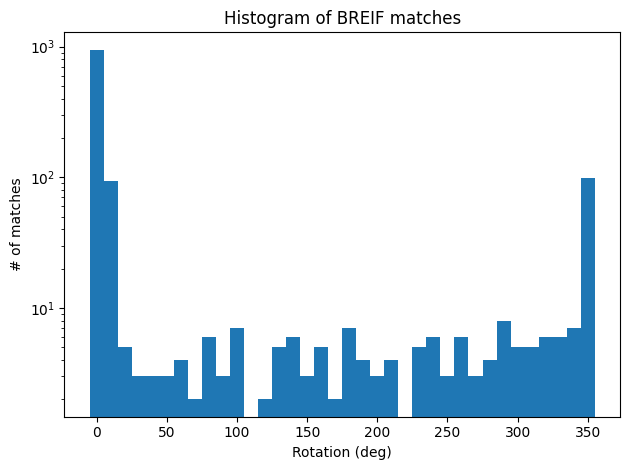

In [38]:
dispBriefRotHist()

---

Explain why you think the BRIEF descriptor behaves this way: From the histogram, we see that the number of matches decreases considerably when the image is rotated significantly. This is because the BRIEF descriptor is not rotation invariant. The BRIEF descriptor compares the intensity values around a keypoint. When the image is rotated, the relative positions of the pixels change, thereby causing different comparisons to be made and resulting in a different binary descriptor. This causes the Hamming distance between the original and rotated keypoints to be large, making $\texttt{briefMatch}$ regarding the two points as not being a match.

---

### Q2.1.7.1 (Extra Credit - 5 points):

Design a fix to make BRIEF more rotation invariant. Feel free to make any helper functions as necessary. But you cannot use any additional OpenCV or Scikit-Image functions.

In [ ]:
# ===== your code here! =====
# TODO: Define any helper functions here
# (Feel free to put anything in its own cell)

# TODO: Feel free to modify the inputs and the function body as necessary
# This is only an outline
def briefRotInvEc(min_deg, max_deg, deg_inc, ratio, sigma, filename):
    """
    Rotation invariant Brief.

    Input
    -----
    min_deg: minimum degree to rotate image
    max_deg: maximum degree to rotate image
    deg_inc: number of degrees to increment when iterating
    ratio: ratio for BRIEF feature descriptor
    sigma: threshold for corner detection using FAST feature detector
    filename: filename of image to rotate

    """

    if not os.path.exists(RES_DIR):
      raise RuntimeError('RES_DIR does not exist. did you run all cells?')

    #Read the image and convert bgr to rgb
    image_path = os.path.join(DATA_DIR, filename)
    image = cv2.imread(image_path)
    if len(image.shape) == 3 and image.shape[2] == 3:
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    match_degrees = [] # stores the degrees of rotation
    match_counts = [] # stores the number of matches at each degree of rotation

    for i in range(min_deg, max_deg, deg_inc):
        print(i)

        # TODO: Rotate Image (Hint: use scipy.ndimage.rotate)

        # TODO: Brief matcher that is rotation invariant
        # Feel free to define additional helper functions as necessary

        # TODO: visualizes matches at at least 3 different orientations
        # to include in your report
        # (Hint: use plotMatches)

        # TODO: Update match_degrees and match_counts (see descriptions above)

    # Save to pickle file
    matches_to_save = [match_counts, match_degrees, deg_inc]
    write_pickle(ROT_INV_MATCHES_PATH, matches_to_save)

# ==== end of code ====

#### Visualize your implemented function


In [ ]:
min_deg = 0
max_deg = 360
deg_inc = 10
filename = 'cv_cover.jpg'

# ===== your code here! =====
# TODO: Call briefRotInvEc and visualize

# ==== end of code ====


#### Plot Histogram

In [ ]:
dispBriefRotHist(matches_path=ROT_INV_MATCHES_PATH)

---

Compare the histograms with an without rotation invariance. Explain your rotation invariant design and how you selected any parameters that you used: YOUR ANSWER HERE...

---

### Q2.1.7.2 (Extra Credit - 5 points):

Design a fix to make BRIEF more scale invariant. Feel free to make any helper functions as necessary. But you cannot use any additional OpenCV or Scikit-Image functions.


In [ ]:
# ===== your code here! =====
# TODO: Define any helper functions here
# (Feel free to put anything in its own cell)

# TODO: Modify the inputs and the function body as necessary
def briefScaleInvEc(ratio, sigma, filename):

    #Read the image and convert bgr to rgb
    image_path = os.path.join(DATA_DIR, filename)
    image = cv2.imread(image_path)
    if len(image.shape) == 3 and image.shape[2] == 3:
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    match_scales = [] # stores the scaling factors
    match_counts = [] # stores the number of matches at each scaling factor

    for i in [1]:
        # Scale Image
        image_scale = cv2.resize(image,(int(image.shape[1]/(2**i)),
                                        int(image.shape[0]/(2**i))),
                                 interpolation = cv2.INTER_AREA)

        # TODO: Brief matcher that is scale invariant
        # Feel free to define additional helper functions as necessary

        # Compare to regular matchPics
        matches_orig, locs1_orig, locs2_orig = matchPics(image,
                                                         image_scale,
                                                         ratio, sigma)

        print('plotting non-scale invariant scale: ', 2**i)
        plotMatches(image, image_scale, matches_orig, locs1_orig,
                    locs2_orig)
        print('plotting scale-invariant: ', 2**i)
        plotMatches(image, image_scale, matches, locs1, locs2)

# ==== end of code ====

#### Visualize your implemented function

In [ ]:
# ===== your code here! =====
# TODO: Call briefScaleInvEc and visualize
# You may change any parameters and the function body as necessary

filename = 'cv_cover.jpg'

ratio = 0.7
sigma = 0.15

briefScaleInvEc(ratio, sigma, filename)
# ==== end of code ====

---

Explain your scale invariant design and how you selected any parameters that you used: YOUR ANSWER HERE...

---


## Q2.2 Homography Computation

### Q2.2.1 (15 Points):

Implement the function computeH

In [39]:
def computeH(x1, x2):
    """
    Compute the homography between two sets of points

    Input
    -----
    x1, x2: Sets of points

    Returns
    -------
    H2to1: 3x3 homography matrix that best transforms x2 to x1
    """

    if x1.shape != x2.shape:
        raise RuntimeError('number of points do not match')

    # ===== your code here! =====
    # TODO: Compute the homography between two sets of points

    num_points = x1.shape[0]
    A = []

    for i in range(num_points):
        x1_i = x1[i, 0]
        y1_i = x1[i, 1]
        x2_i = x2[i, 0]
        y2_i = x2[i, 1]

        # Construct the two rows of matrix A
        row1 = [x2_i, y2_i, 1, 0, 0, 0, -x1_i*x2_i, -x1_i*y2_i, -x1_i]
        row2 = [0, 0, 0, x2_i, y2_i, 1, -y1_i*x2_i, -y1_i*y2_i, -y1_i]

        A.append(row1)
        A.append(row2)

    A = np.array(A)

    # Solve Ah = 0 using SVD, the nullspace is the last row of VT
    U, S, VT = np.linalg.svd(A)
    h = VT[-1, :]

    # Normalize vector with last element to 1 for numerical stability
    h = h / h[-1]

    # Reshape h to a 3x3 matrix
    H2to1 = h.reshape((3, 3))

    # ==== end of code ====

    return H2to1

### Q2.2.2 (10 points):

Implement the function computeH_norm

In [40]:
def computeH_norm(x1, x2):
    """
    Compute the homography between two sets of points using normalization

    Input
    -----
    x1, x2: Sets of points

    Returns
    -------
    H2to1: 3x3 homography matrix that best transforms x2 to x1
    """

    # ===== your code here! =====

    # TODO: Compute the centroid of the points
    centroid1 = np.mean(x1, axis=0)
    centroid2 = np.mean(x2, axis=0)

    # TODO: Shift the origin of the points to the centroid
    x1_shifted = x1 - centroid1
    x2_shifted = x2 - centroid2

    # TODO: Normalize the points so that the largest distance from the
    # origin is equal to sqrt(2)
    max_dist1 = np.max(np.linalg.norm(x1_shifted, axis=1))
    max_dist2 = np.max(np.linalg.norm(x2_shifted, axis=1))

    scalar1 = np.sqrt(2) / max_dist1
    scalar2 = np.sqrt(2) / max_dist2

    x1_normalized = scalar1 * x1_shifted
    x2_normalized = scalar2 * x2_shifted

    # TODO: Similarity transform 1
    T1 = np.array([[scalar1, 0, -scalar1 * centroid1[0]],
                   [0, scalar1, -scalar1 * centroid1[1]],
                   [0, 0, 1]])

    # TODO: Similarity transform 2
    T2 = np.array([[scalar2, 0, -scalar2 * centroid2[0]],
                   [0, scalar2, -scalar2 * centroid2[1]],
                   [0, 0, 1]])

    # TODO: Compute homography
    H_normalized = computeH(x1_normalized, x2_normalized)

    # TODO: Denormalization
    H2to1 = np.linalg.inv(T1) @ H_normalized @ T2

    # ==== end of code ====

    return H2to1

### Q2.2.3 (25 points):

Implement RANSAC

In [41]:
def computeH_ransac(locs1, locs2, max_iters, inlier_tol):
    """
    Estimate the homography between two sets of points using ransac

    Input
    -----
    locs1, locs2: Lists of points
    max_iters: the number of iterations to run RANSAC for
    inlier_tol: the tolerance value for considering a point to be an inlier

    Returns
    -------
    bestH2to1: 3x3 homography matrix that best transforms locs2 to locs1
    inliers: indices of RANSAC inliers

    """

    # ===== your code here! =====

    # TODO:
    # Compute the best fitting homography using RANSAC
    # given a list of matching points locs1 and loc2

    num_points = locs1.shape[0]
    bestH2to1 = None
    best_inliers = np.zeros(num_points)
    max_inliers = 0

    for iter in range(max_iters):

        sample_points = np.random.choice(num_points, 4, replace=False)
        locs1_sample = locs1[sample_points, :]
        locs2_sample = locs2[sample_points, :]

        # Compute normalized homography
        H = computeH_norm(locs1_sample, locs2_sample)

        # Convert points to homogeneous coordinates
        locs2_h = np.hstack([locs2, np.ones((num_points, 1))])

        # Compute normalized estimates of x1 points using the homography
        locs1_h_est = (H @ locs2_h.T).T
        locs1_h_est_3rd_cord = locs1_h_est[:, 2][:, np.newaxis]
        locs1_h_est_normalized = locs1_h_est / locs1_h_est_3rd_cord

        # Convert back to non-homogeneous coordinates
        locs1_est_normalized = locs1_h_est_normalized[:, :2]

        # Determine number of inliers
        dist = np.linalg.norm(locs1_est_normalized - locs1, axis=1)
        inliers = dist < inlier_tol

        # If more inliers, recalculate homography based on all inliers
        if sum(inliers) > max_inliers:
            inlier_index = np.where(inliers)[0]
            locs1_inliers = locs1[inlier_index, :]
            locs2_inliers = locs2[inlier_index, :]
            bestH2to1 = computeH_norm(locs1_inliers, locs2_inliers)
            best_inliers = inliers
            max_inliers = sum(inliers)

    # ==== end of code ====

    return bestH2to1, best_inliers

### Q2.2.4 (10 points):

#### Implement the function compositeH

In [42]:
def compositeH(H2to1, template, img):
    """
    Returns the composite image.

    Input
    -----
    H2to1: Homography from image to template
    template: template image to be warped
    img: background image

    Returns
    -------
    composite_img: Composite image

    """

    # ===== your code here! =====
    # TODO: Create a composite image after warping the template image on top
    # of the image using the homography

    img_size = (img.shape[1], img.shape[0])

    # Warp perspective of template image
    warped_template = cv2.warpPerspective(template, H2to1, img_size)

    # Remove area where the warped template is to be placed
    mask = np.any(warped_template > 0, axis=2)
    img[mask == True] = 0

    composite_img = img + warped_template

    # ==== end of code ====

    return composite_img

#### Implement the function warpImage

In [43]:
def warpImage(ratio, sigma, max_iters, inlier_tol):
    """
    Warps hp_cover.jpg onto the book cover in cv_desk.png.

    Input
    -----
    ratio: ratio for BRIEF feature descriptor
    sigma: threshold for corner detection using FAST feature detector
    max_iters: the number of iterations to run RANSAC for
    inlier_tol: the tolerance value for considering a point to be an inlier

    """

    hp_cover = skimage.io.imread(os.path.join(DATA_DIR, 'hp_cover.jpg'))
    cv_cover = skimage.io.imread(os.path.join(DATA_DIR, 'cv_cover.jpg'))
    cv_desk = skimage.io.imread(os.path.join(DATA_DIR, 'cv_desk.png'))
    cv_desk = cv_desk[:, :, :3]

    # ===== your code here! =====

    # TODO: match features between cv_desk and cv_cover using matchPics
    matches, feat_locs1, feat_locs2 = matchPics(cv_desk, cv_cover, ratio, sigma)

    # Finding locations of matched features only
    locs1 = []
    locs2 = []
    for match in matches:
        # locs produced by matchPics are in (y,x) coordinates
        locs1.append([feat_locs1[match[0]][1], feat_locs1[match[0]][0]])
        locs2.append([feat_locs2[match[1]][1], feat_locs2[match[1]][0]])
    locs1 = np.array(locs1)
    locs2 = np.array(locs2)

    # TODO: Scale matched pixels in cv_cover to size of hp_cover
    # NOTE: Scaling pixels in hp_cover to size of cv_cover instead
    # Convert from (y,x) format to (x,y)
    cv_cover_size = (cv_cover.shape[1],  cv_cover.shape[0])
    hp_cover_resized = cv2.resize(hp_cover, cv_cover_size)

    # TODO: Get homography by RANSAC using computeH_ransac
    H2to1, inliers = computeH_ransac(locs1, locs2, max_iters, inlier_tol)


    # TODO: Overlay using compositeH to return composite_img
    composite_img = compositeH(H2to1, hp_cover_resized, cv_desk)

    # ==== end of code ====

    plt.imshow(composite_img)
    plt.show()

#### Visualize composite image

<ipython-input-30-93856fa3ecc0>:58: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return 1 if img[int(center[0]+row1)][int(center[1]+col1)] < img[int(center[0]+row2)][int(center[1]+col2)] else 0


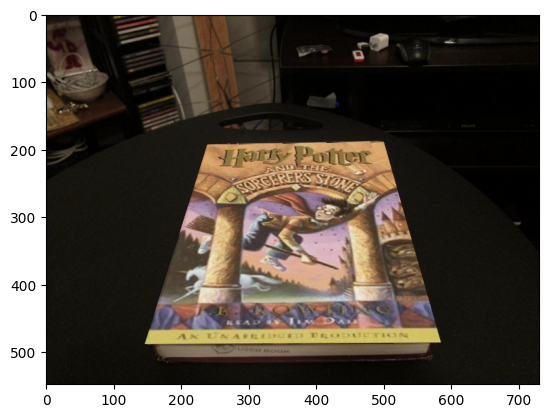

In [44]:
# defaults are:
# ratio = 0.7
# sigma = 0.15
# max_iters = 600
# inlier_tol = 1.0

# (no need to change this but can if you want to experiment)
ratio = 0.7
sigma = 0.15
max_iters = 600
inlier_tol = 1.0

warpImage(ratio, sigma, max_iters, inlier_tol)

### Q2.2.5 (10 points):

Conduct ablation study with various max_iters and inlier_tol values. Plot the result images and explain the effect of these two parameters respectively.

max_iters: 1, inlier_tol: 0.5


<ipython-input-30-93856fa3ecc0>:58: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return 1 if img[int(center[0]+row1)][int(center[1]+col1)] < img[int(center[0]+row2)][int(center[1]+col2)] else 0


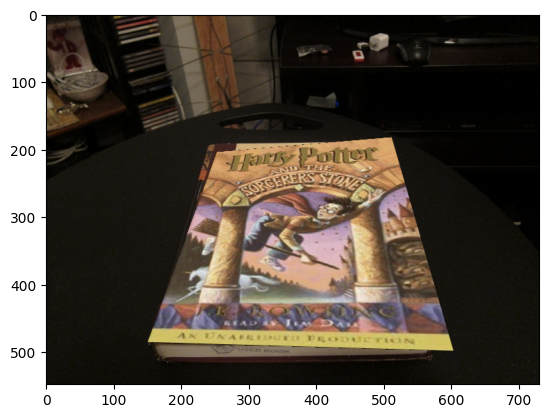

max_iters: 1, inlier_tol: 1


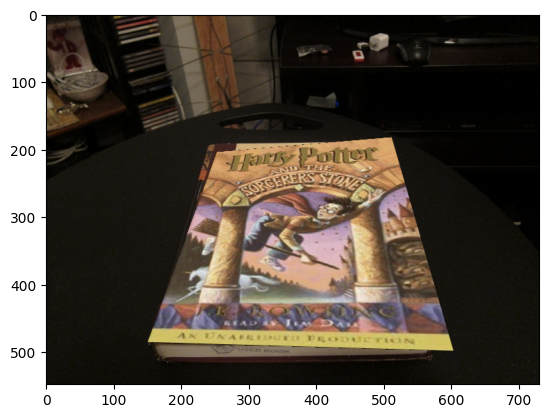

max_iters: 1, inlier_tol: 2


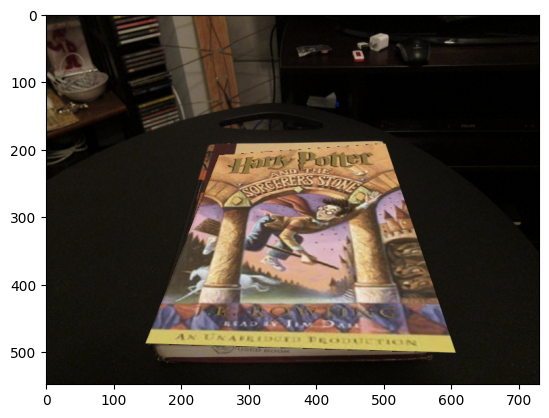

max_iters: 1, inlier_tol: 5


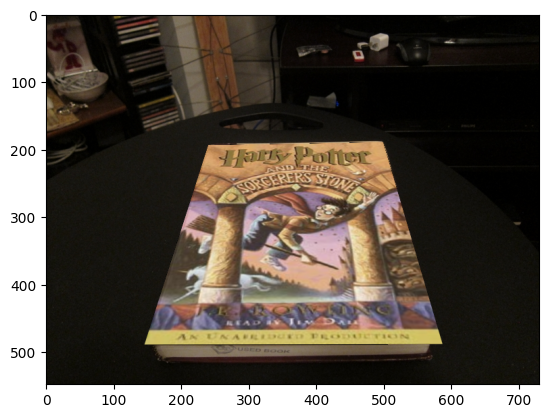

max_iters: 1, inlier_tol: 10


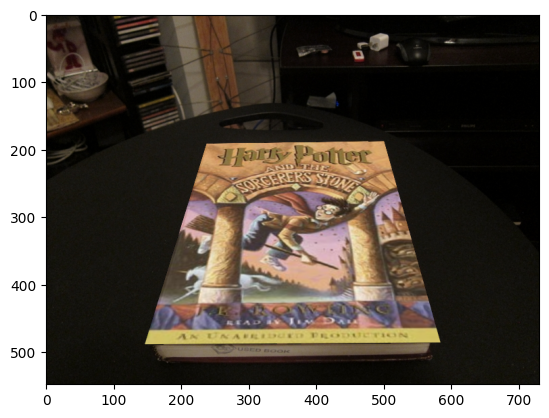

max_iters: 1, inlier_tol: 20


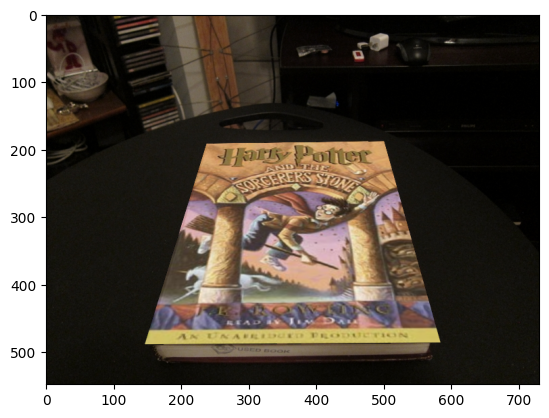

max_iters: 1, inlier_tol: 50


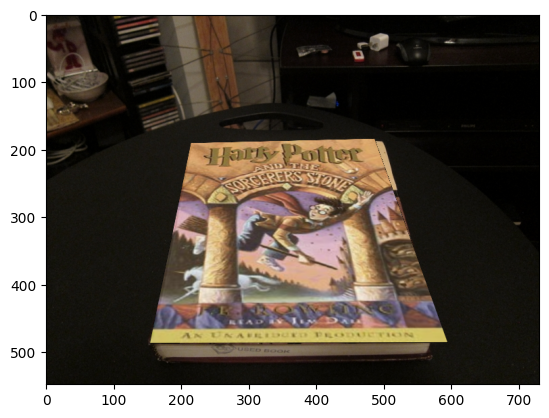

max_iters: 1, inlier_tol: 100


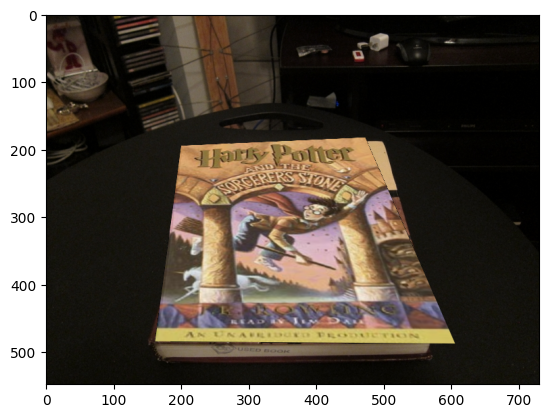

max_iters: 10, inlier_tol: 0.5


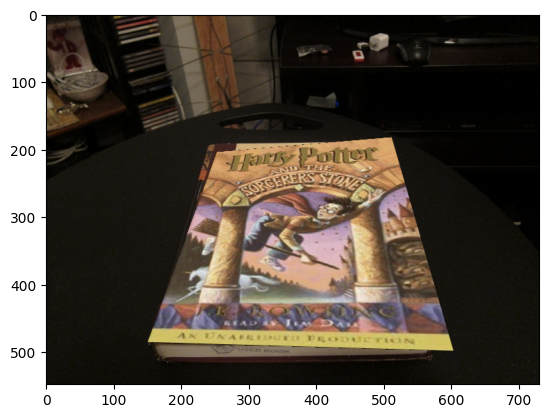

max_iters: 10, inlier_tol: 1


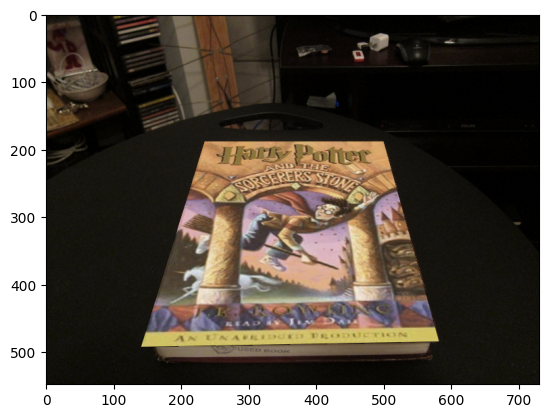

max_iters: 10, inlier_tol: 2


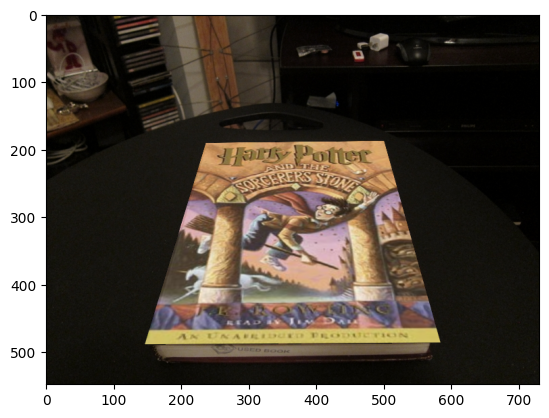

max_iters: 10, inlier_tol: 5


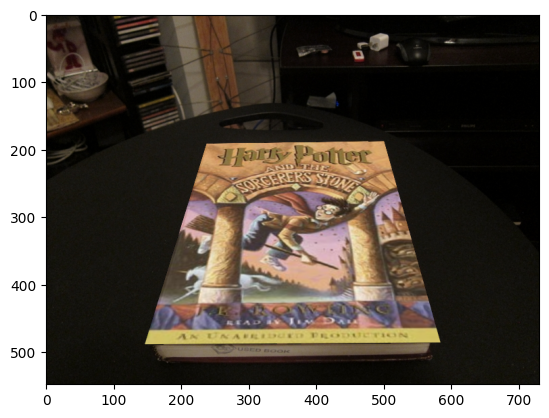

max_iters: 10, inlier_tol: 10


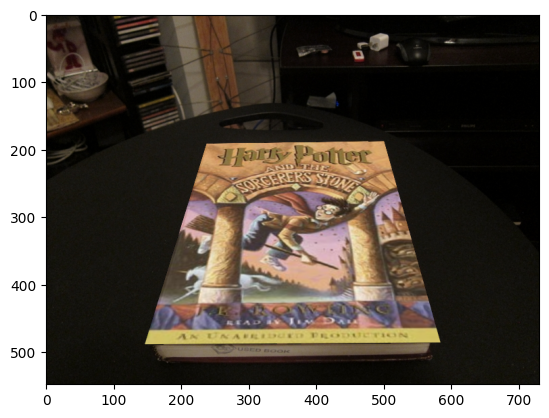

max_iters: 10, inlier_tol: 20


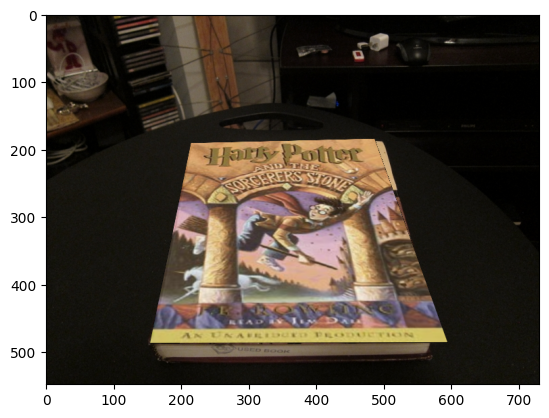

max_iters: 10, inlier_tol: 50


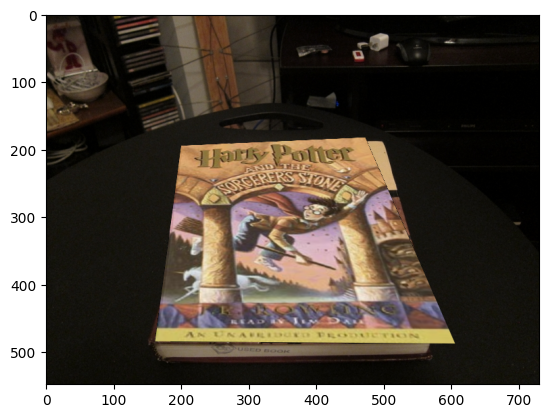

max_iters: 10, inlier_tol: 100


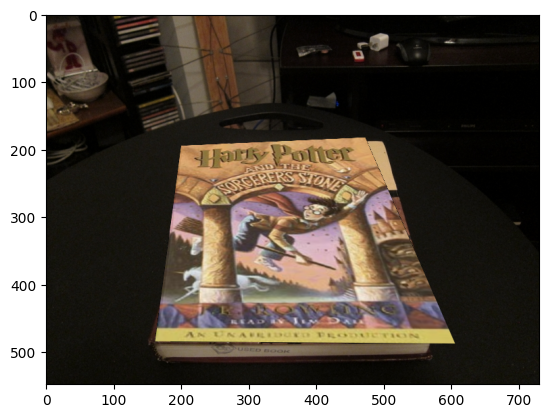

max_iters: 100, inlier_tol: 0.5


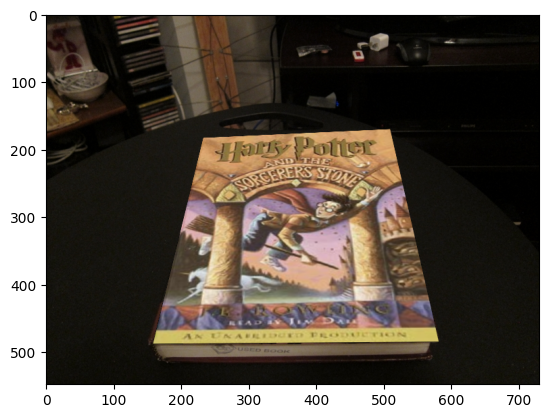

max_iters: 100, inlier_tol: 1


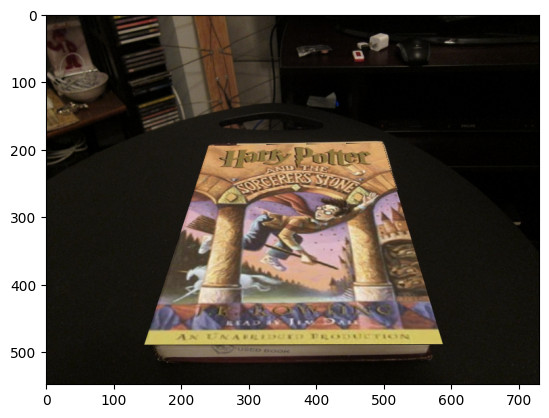

max_iters: 100, inlier_tol: 2


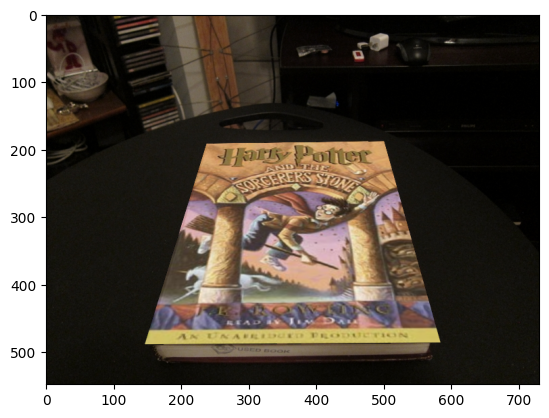

max_iters: 100, inlier_tol: 5


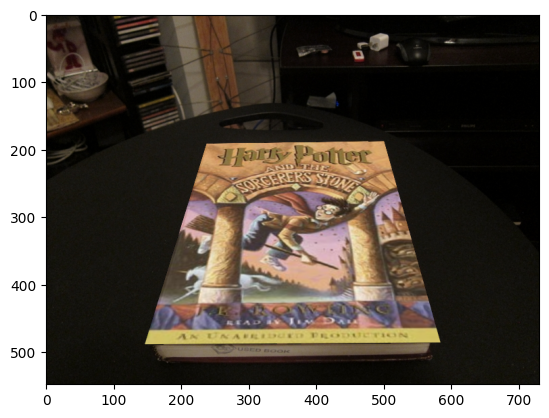

max_iters: 100, inlier_tol: 10


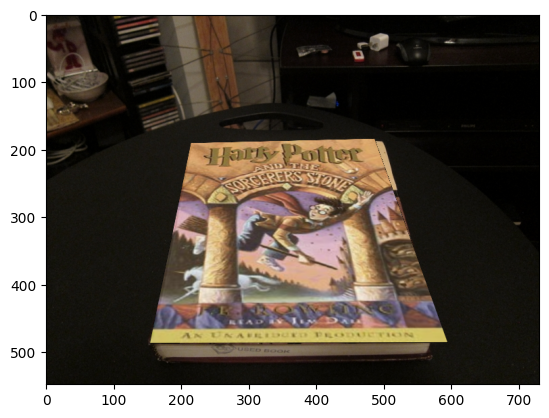

max_iters: 100, inlier_tol: 20


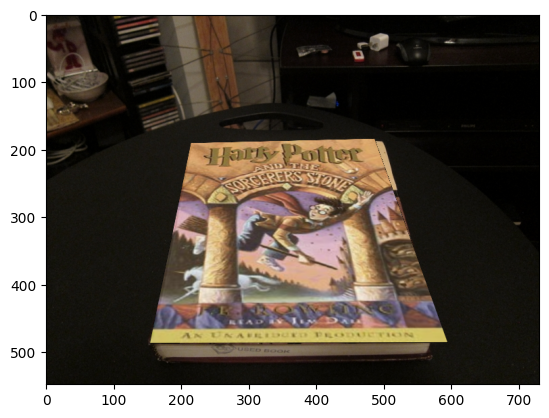

max_iters: 100, inlier_tol: 50


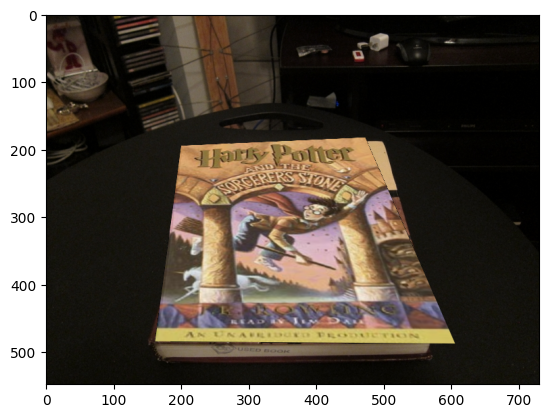

max_iters: 100, inlier_tol: 100


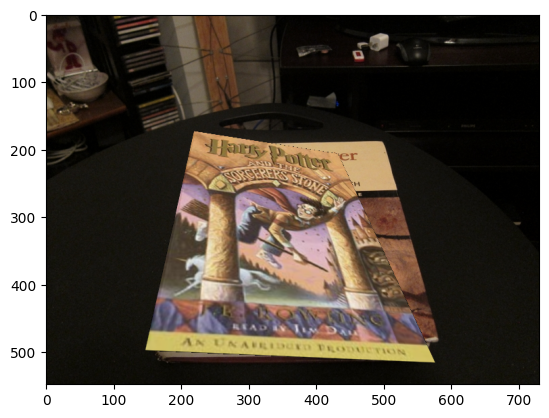

max_iters: 250, inlier_tol: 0.5


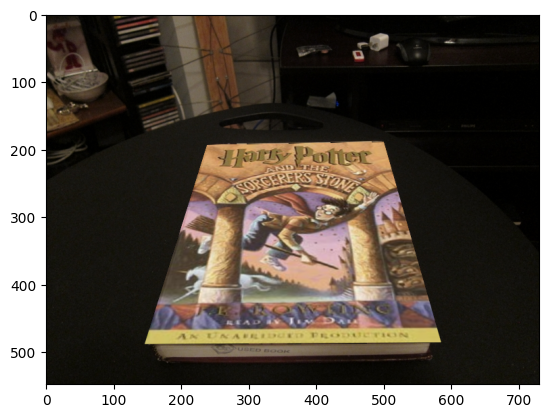

max_iters: 250, inlier_tol: 1


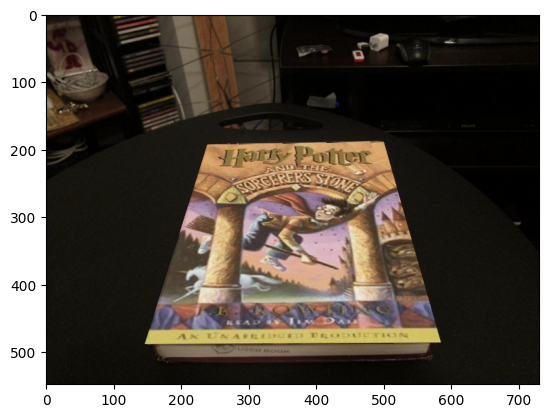

max_iters: 250, inlier_tol: 2


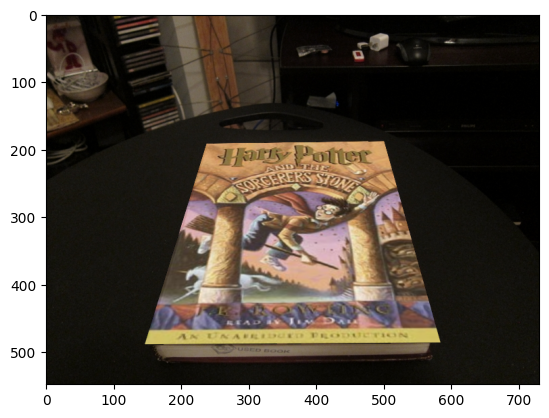

max_iters: 250, inlier_tol: 5


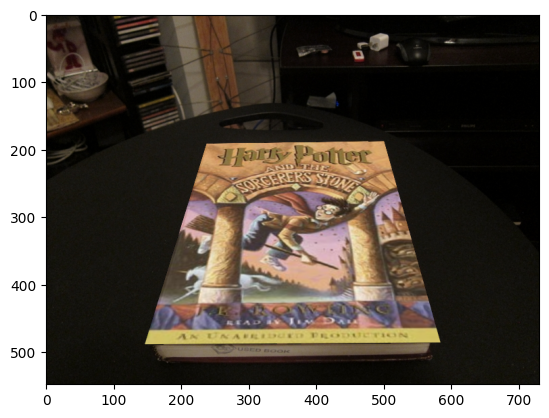

max_iters: 250, inlier_tol: 10


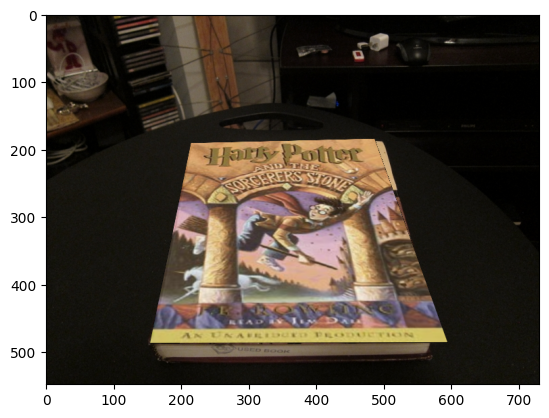

max_iters: 250, inlier_tol: 20


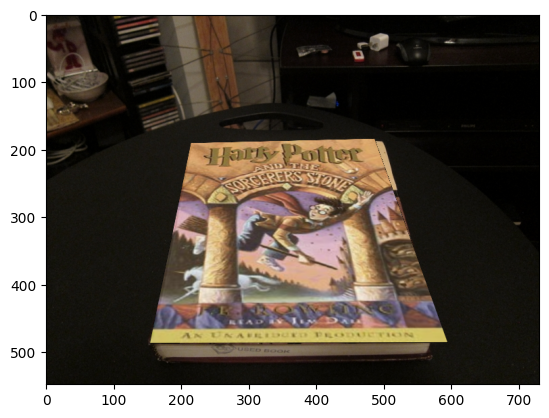

max_iters: 250, inlier_tol: 50


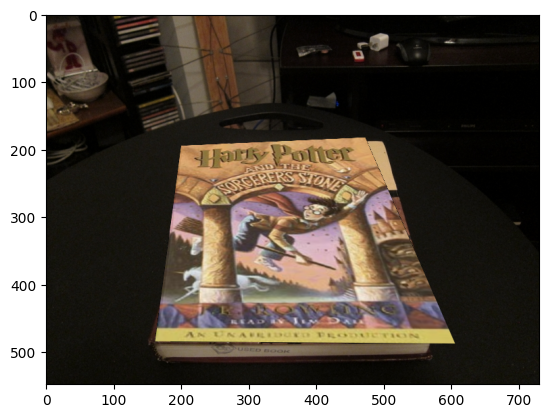

max_iters: 250, inlier_tol: 100


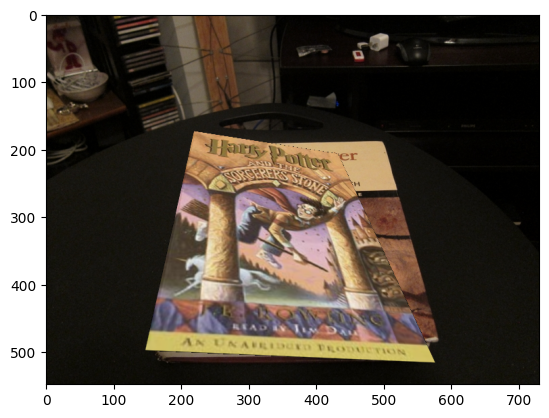

max_iters: 500, inlier_tol: 0.5


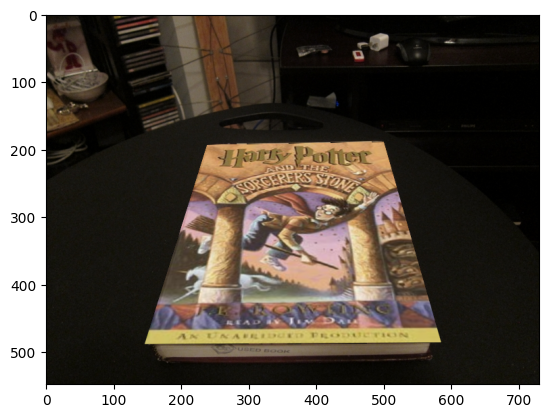

max_iters: 500, inlier_tol: 1


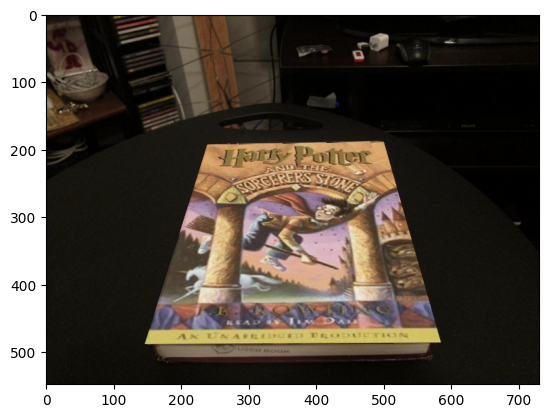

max_iters: 500, inlier_tol: 2


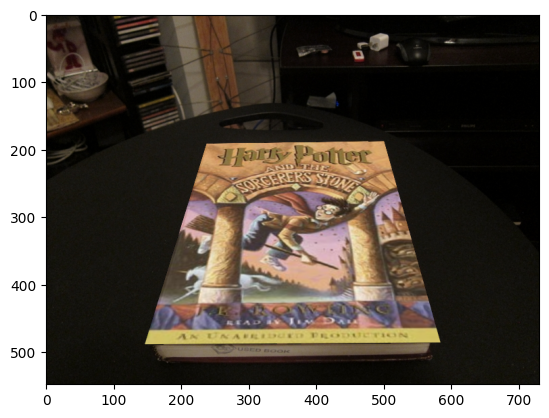

max_iters: 500, inlier_tol: 5


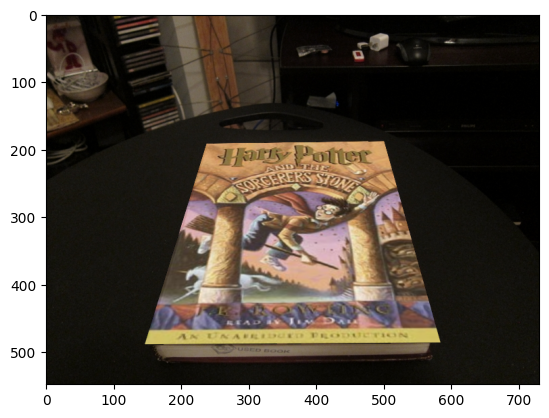

max_iters: 500, inlier_tol: 10


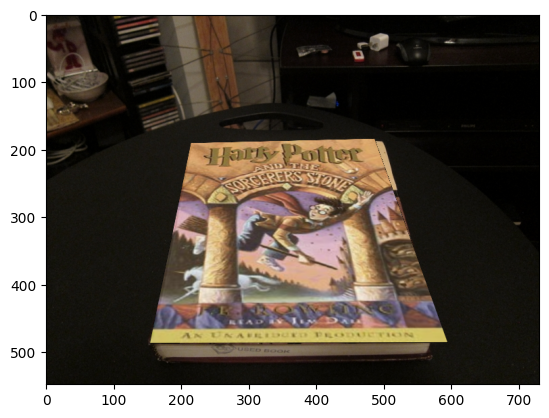

max_iters: 500, inlier_tol: 20


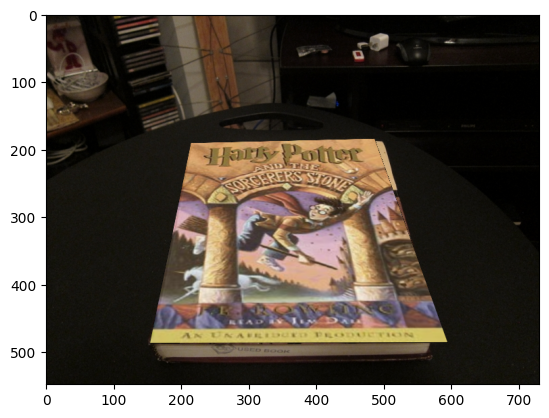

max_iters: 500, inlier_tol: 50


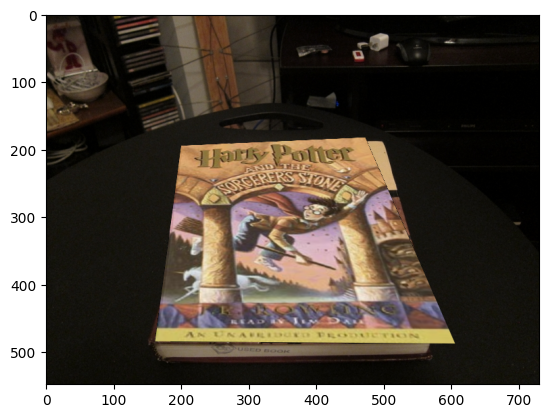

max_iters: 500, inlier_tol: 100


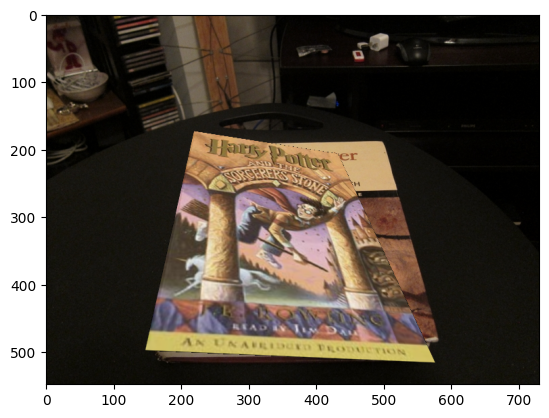

max_iters: 750, inlier_tol: 0.5


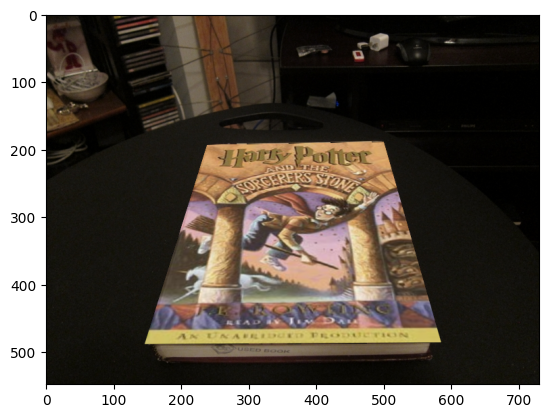

max_iters: 750, inlier_tol: 1


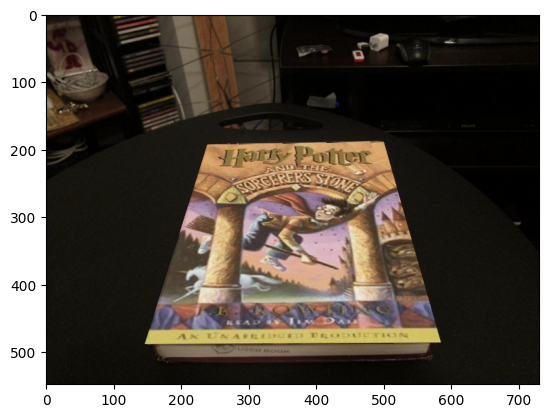

max_iters: 750, inlier_tol: 2


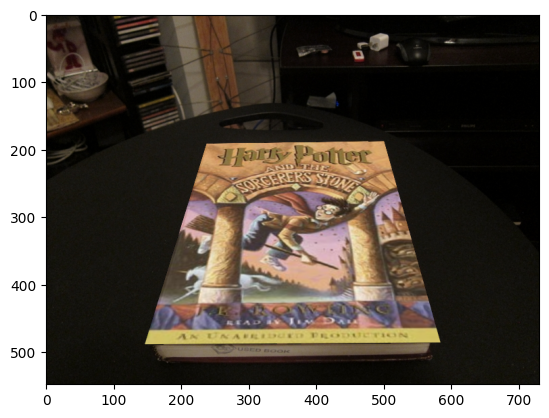

max_iters: 750, inlier_tol: 5


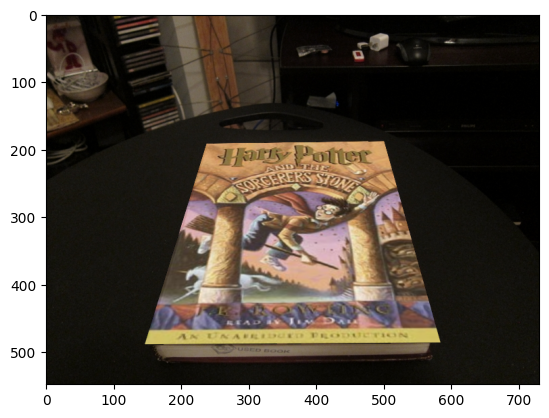

max_iters: 750, inlier_tol: 10


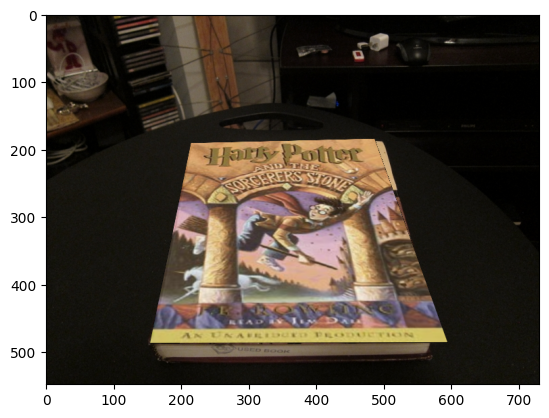

max_iters: 750, inlier_tol: 20


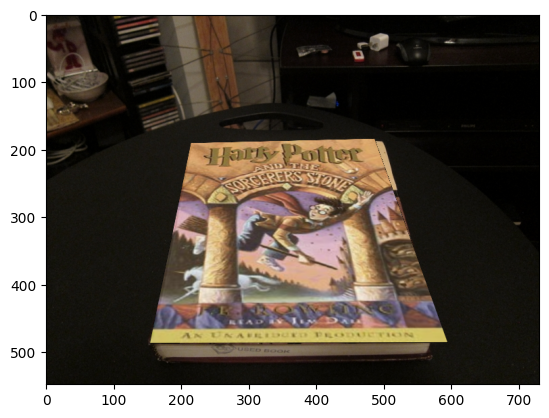

max_iters: 750, inlier_tol: 50


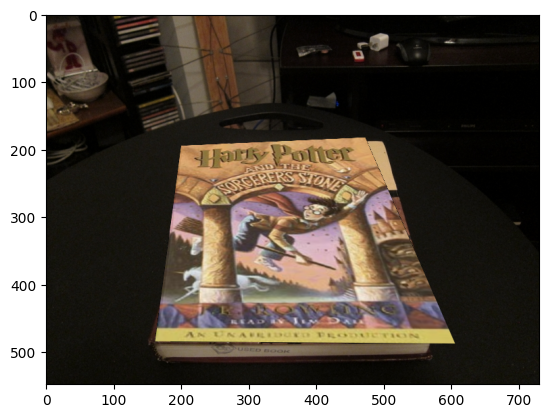

max_iters: 750, inlier_tol: 100


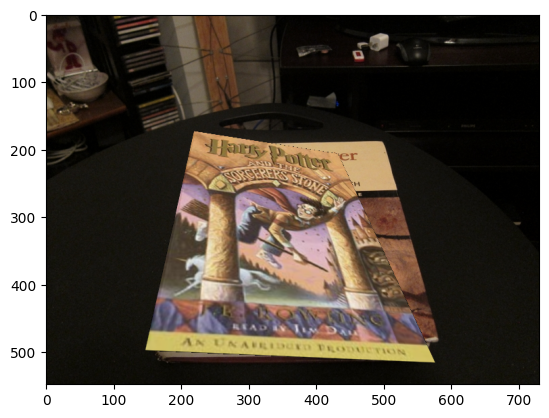

max_iters: 1000, inlier_tol: 0.5


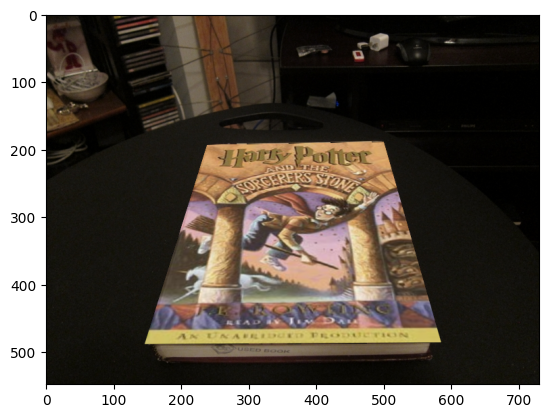

max_iters: 1000, inlier_tol: 1


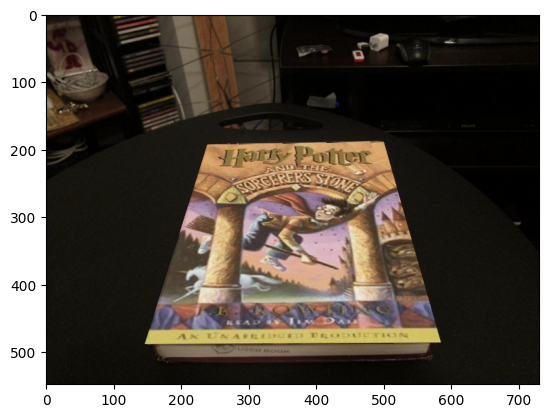

max_iters: 1000, inlier_tol: 2


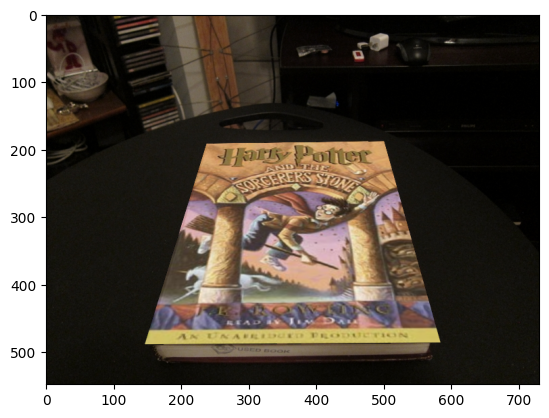

max_iters: 1000, inlier_tol: 5


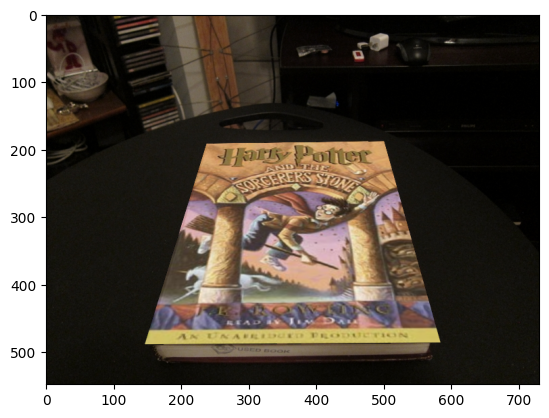

max_iters: 1000, inlier_tol: 10


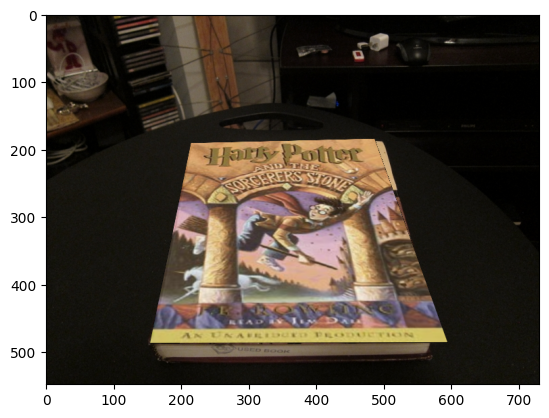

max_iters: 1000, inlier_tol: 20


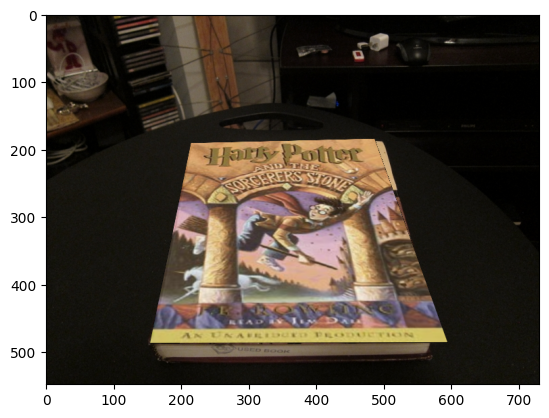

max_iters: 1000, inlier_tol: 50


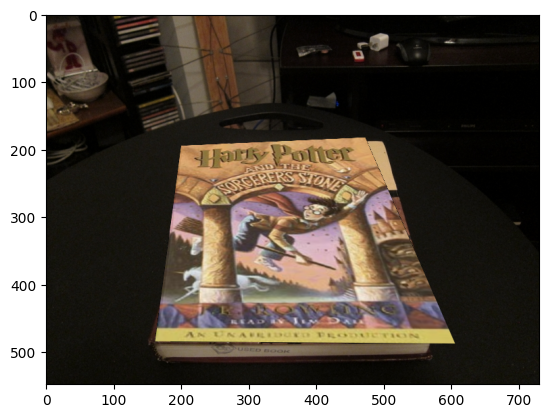

max_iters: 1000, inlier_tol: 100


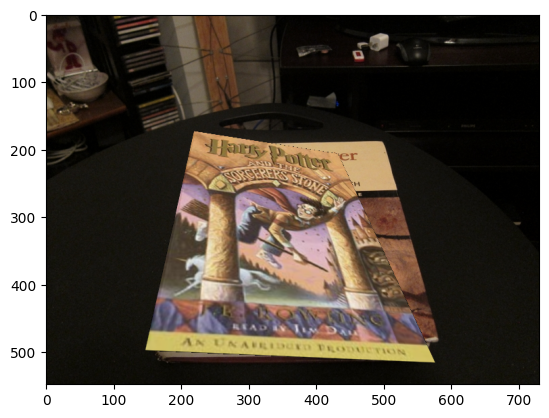

In [45]:
# ===== your code here! =====
# Experiment with different max_iters and inlier_tol values.
# Include the result images in the write-up.
ratio = 0.7
sigma = 0.15

max_iters_list = [1, 10, 100, 250, 500, 750, 1000]
inlier_tol_list = [0.5, 1, 2, 5, 10, 20, 50, 100]

for max_iters in max_iters_list:
    for inlier_tol in inlier_tol_list:
        print(f"max_iters: {max_iters}, inlier_tol: {inlier_tol}")
        warpImage(ratio, sigma, max_iters, inlier_tol)

# ==== end of code ====

---

Explain the effect of max_iters and inlier_tol: From the ablation study, we can see that increasing max_iters while holding inlier_tol constant in general tends to increase the stability of producing accurate results. Holding max_iters constant, we see that increasing inlier_tol initially increases the accuracy of the composition. However, after a certain cutoff (around 10), further increases in inlier_tol actually decreases the accuracy of the composition. We will explain them in turn:

The max_iters parameter determines the amount of iterations we run the RANSAC algorithm. The more times we run it, the greater the likelihood that we will randomly pick 4 initial values that are all good inliers. This will generate a better initial homography that best caputures most of the inliers. The homography computed from this set of inliers is more accurate. As such, increasing max_iters in general results in better accuracy in the composition. At very low max_iters values (i.e. below 100), there is the not-so-remote chance that all the iterations computed bad homographies from bad initial values, thus the accuracy of the results are not very stable. However, after around 500 iterations, the increase in accuracy is miniscule. This is because the RANSAC algorithm most likely have already chosen 4 initial values that are all good inliers and computed a very good homography. Choosing additional random values might only slightly outperform this homography on the odd chance that 4 even better initial values are chosen.

The inlier_tol parameter determines the tolerance a point is considered an inlier or outlier. Setting the tolerance too low (i.e. 0.5) might be too strict and classify actual inliers as outliers simply due to noise in the data. One the other hand, setting the tolerance too high (i.e. >10) will result in outliers being classified as inliers. Both the inclusion of outliers and the exclusion of inliers will lead to a bad homography. Between 0.5 and 10 seems to be a robust inlier_tol value that accurately picks up inliers with discarding outliers.

In actuality, the effects of max_iters and inlier_tol are not independent as both work together to tune the homography. You can never reliably get an accurate and stable composition with $\texttt{max_iters=1}$ regardless of how well you tune inlier_tol. The similar is true in reverse. From the ablation study, the optimal values for the two parameters seems to be $\texttt{max_iters} \in [100, 500]$ and $\texttt{inlier_tol} \in [1, 10]$. Parameters in this range ensures the RANSAC algorithm is reliably able to choose a good initial homography and that inliers and outliers can be reliably separated.



---

# Q3 Create a Simple Panorama

## Q3.1 Create a panorama (10 points):

#### Implement the function createPanorama

In [46]:
def createPanorama(left_im, right_im, ratio, sigma, max_iters, inlier_tol):
    """
    Create a panorama augmented reality application by computing a homography
    and stitching together a left and right image.

    Input
    -----
    left_im: left image
    right_im: right image
    ratio: ratio for BRIEF feature descriptor
    sigma: threshold for corner detection using FAST feature detector
    max_iters: the number of iterations to run RANSAC for
    inlier_tol: the tolerance value for considering a point to be an inlier

    Returns
    -------
    panorama_im: Stitched together panorama

    """

    # ===== your code here! =====
    # TODO: match features between images
    # This can be done using matchPics, cpselect, or any other function.
    matches, feat_locs1, feat_locs2 = matchPics(left_im, right_im, ratio, sigma)

    # Finding locations of matched features only
    locs1 = []
    locs2 = []
    for match in matches:
        # locs produced by matchPics are in (y,x) coordinates
        locs1.append([feat_locs1[match[0]][1], feat_locs1[match[0]][0]])
        locs2.append([feat_locs2[match[1]][1], feat_locs2[match[1]][0]])
    locs1 = np.array(locs1)
    locs2 = np.array(locs2)

    # TODO: Get homography by RANSAC using computeH_ransac
    H2to1, inliers = computeH_ransac(locs1, locs2, max_iters, inlier_tol)

    # TODO: Stich together the two images
    # Requires the use of cv2.warpPerspective

    left_im_height = left_im.shape[0]
    left_im_width = left_im.shape[1]
    right_im_height = right_im.shape[0]
    right_im_width = right_im.shape[1]

    # Create larger canvas for panorama with left image
    panorama_width = left_im_width + right_im_width
    panorama_height = left_im_height + right_im_height

    panorama_im = np.zeros((panorama_height, panorama_width, 3))
    panorama_im[:left_im_height, :left_im_width] = left_im

    # Append right image onto canvas
    panorama_im = compositeH(H2to1, right_im, panorama_im)

    # Crop panorama to remove excess borders
    used_canvas = np.any(panorama_im > 0, axis=2)
    used_rows = np.where(np.any(used_canvas, axis=1))[0]
    used_cols = np.where(np.any(used_canvas, axis=0))[0]

    panorama_im = panorama_im[used_rows[0]:used_rows[-1]+1, used_cols[0]:used_cols[-1]+1]

    # ==== end of code ====

    return panorama_im.astype(np.uint8)

#### Visualize Panorama

Make sure to use **your own images** and **include them as well as the result** in the report.

<ipython-input-30-93856fa3ecc0>:58: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return 1 if img[int(center[0]+row1)][int(center[1]+col1)] < img[int(center[0]+row2)][int(center[1]+col2)] else 0


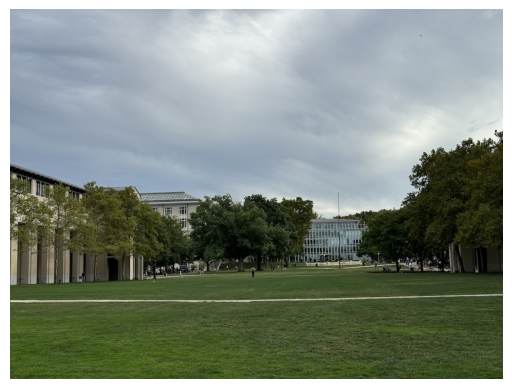

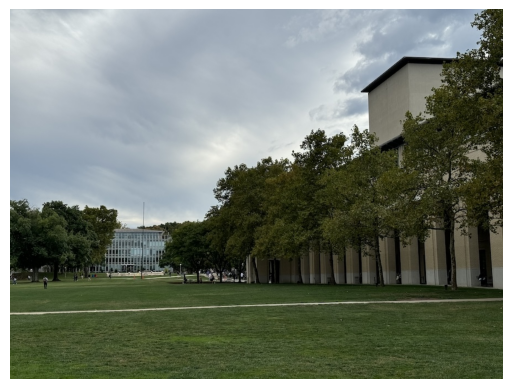

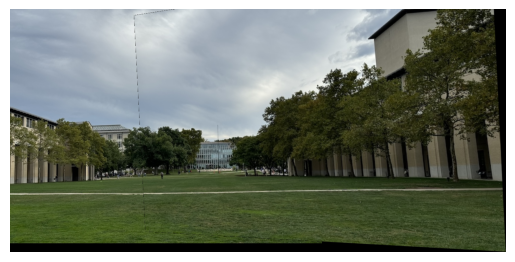

In [47]:
left_im_path = os.path.join(DATA_DIR, 'custom_pano_left.jpg')
left_im = skimage.io.imread(left_im_path)
right_im_path = os.path.join(DATA_DIR, 'custom_pano_right.jpg')
right_im = skimage.io.imread(right_im_path)

# Feel free to adjust as needed
ratio = 0.7
sigma = 0.15
max_iters = 600
inlier_tol = 1.0

panorama_im = createPanorama(left_im, right_im, ratio, sigma, max_iters, inlier_tol)

plt.imshow(left_im)
plt.axis('off')
plt.show()

plt.imshow(right_im)
plt.axis('off')
plt.show()

plt.imshow(panorama_im)
plt.axis('off')
plt.show()